<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_crop_no_duplicate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)
image_index = 0
bb_train = np.zeros((len(X_train),4))
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                #print(temp_array)
                bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])
            image_index += 1
            count += 1
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
bb_test = np.zeros((len(X_test),4))
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])
            image_index += 1
            count_test += 1
print(bb_test[30])
print(extRight_coords_x_test[30])
print(extLeft_coords_x_test[30])

[124.42452099  66.77324418  27.7127405   30.13654925]
383
141


In [10]:
len(X_train)

878

In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [13]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [14]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [15]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [16]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [17]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
callbacks_list = [
    ShowTestImages()
]

In [21]:
effnet = EfficientNetB0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = tf.keras.layers.Flatten()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

16705208/16705208 [==============================] - 2s 0us/step


In [22]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/100
7/7 [==============================] - 0s 36ms/step


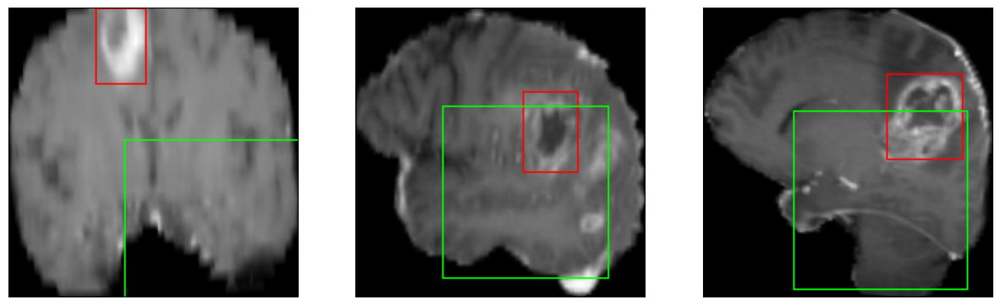

50/50 [==============================] - 67s 264ms/step - loss: 52.6937 - IoU: 6.1305e-04 - val_loss: 54.3711 - val_IoU: 0.0635
Epoch 2/100
7/7 [==============================] - 0s 36ms/step


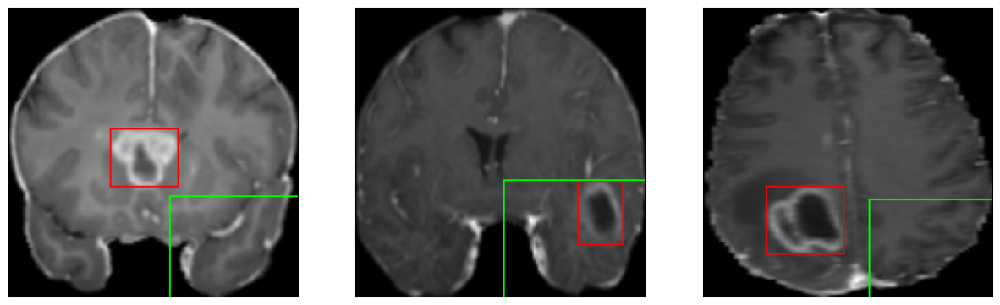

50/50 [==============================] - 6s 128ms/step - loss: 29.4527 - IoU: 0.0496 - val_loss: 82.1057 - val_IoU: 0.0092
Epoch 3/100
7/7 [==============================] - 0s 36ms/step


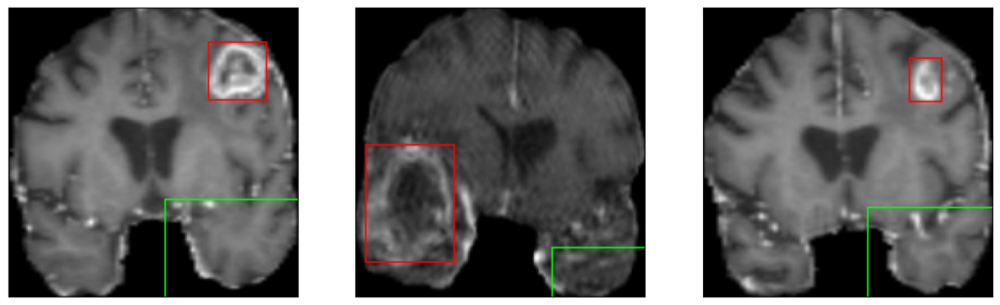

50/50 [==============================] - 7s 131ms/step - loss: 20.3226 - IoU: 0.1151 - val_loss: 58.2652 - val_IoU: 0.0048
Epoch 4/100
7/7 [==============================] - 0s 36ms/step


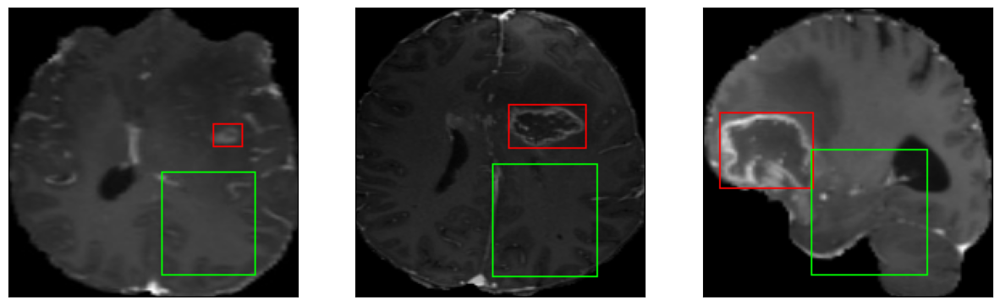

50/50 [==============================] - 7s 133ms/step - loss: 17.0207 - IoU: 0.1491 - val_loss: 32.2940 - val_IoU: 0.0615
Epoch 5/100
7/7 [==============================] - 0s 36ms/step


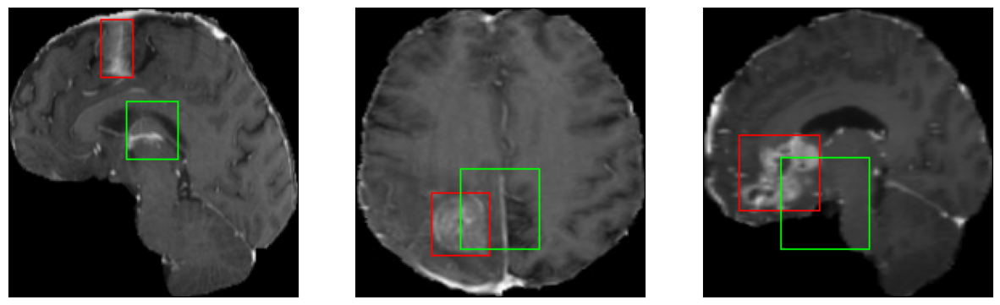

50/50 [==============================] - 7s 140ms/step - loss: 13.7442 - IoU: 0.2226 - val_loss: 21.8769 - val_IoU: 0.0783
Epoch 6/100
7/7 [==============================] - 0s 39ms/step


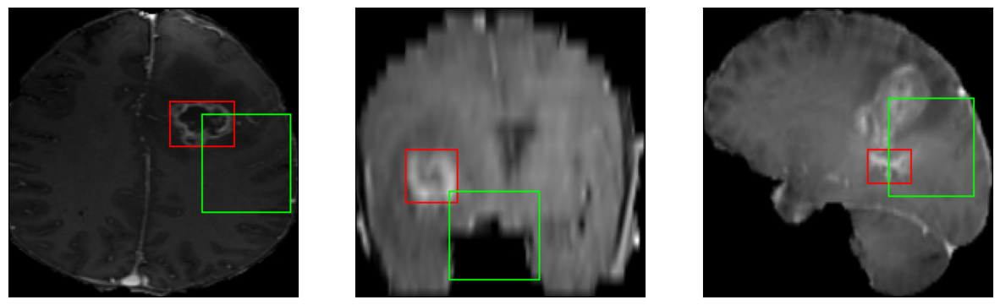

50/50 [==============================] - 7s 142ms/step - loss: 10.2594 - IoU: 0.3378 - val_loss: 29.7848 - val_IoU: 0.0700
Epoch 7/100
7/7 [==============================] - 0s 37ms/step


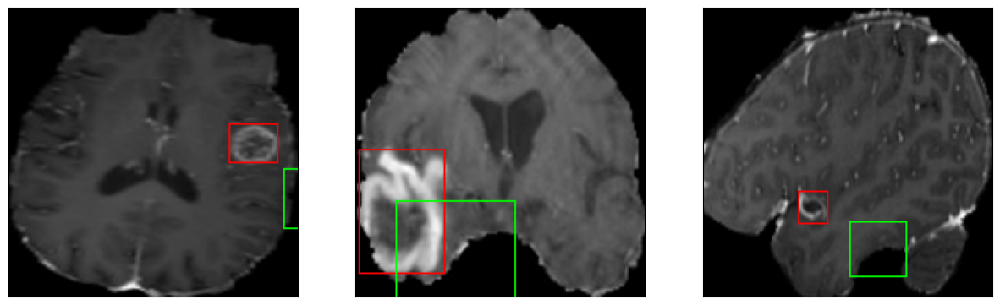

50/50 [==============================] - 7s 134ms/step - loss: 8.8568 - IoU: 0.3846 - val_loss: 25.6615 - val_IoU: 0.0475
Epoch 8/100
7/7 [==============================] - 0s 37ms/step


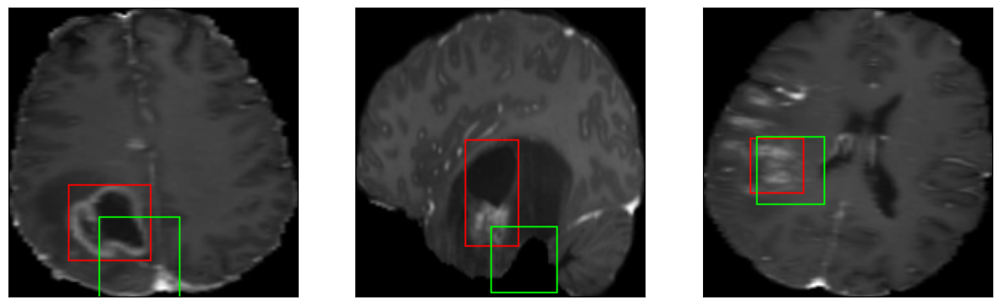

50/50 [==============================] - 7s 141ms/step - loss: 8.5837 - IoU: 0.3934 - val_loss: 12.2724 - val_IoU: 0.2581
Epoch 9/100
7/7 [==============================] - 0s 37ms/step


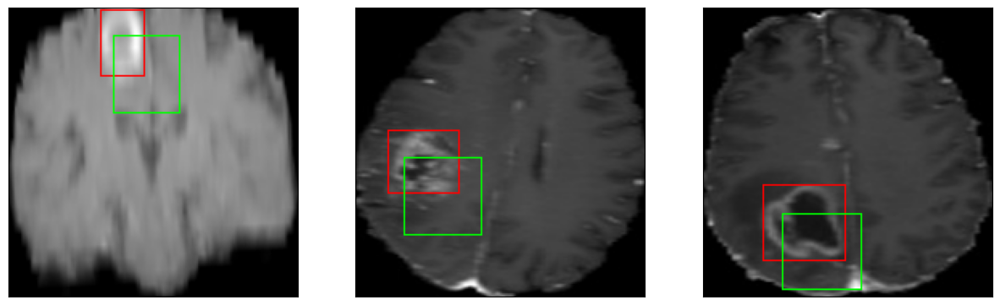

50/50 [==============================] - 7s 139ms/step - loss: 7.7962 - IoU: 0.4344 - val_loss: 16.3037 - val_IoU: 0.1404
Epoch 10/100
7/7 [==============================] - 0s 37ms/step


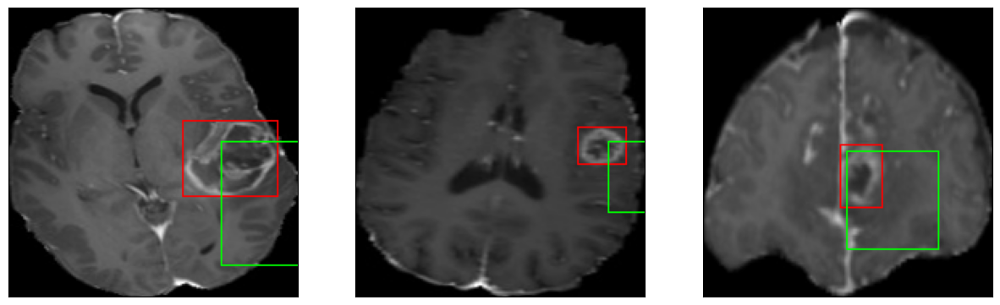

50/50 [==============================] - 7s 133ms/step - loss: 7.4430 - IoU: 0.4360 - val_loss: 22.3022 - val_IoU: 0.1515
Epoch 11/100
7/7 [==============================] - 0s 40ms/step


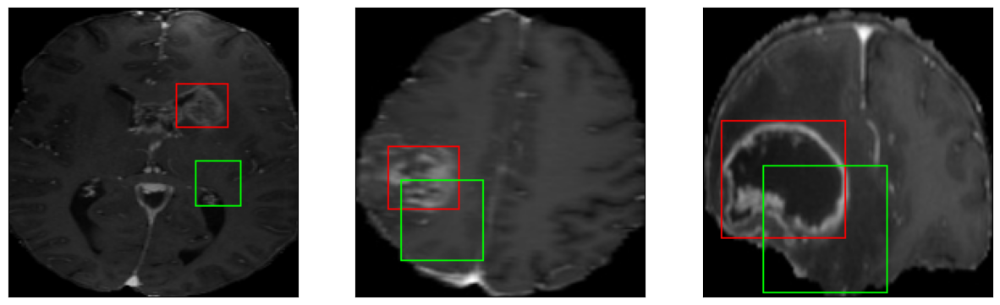

50/50 [==============================] - 7s 145ms/step - loss: 7.6975 - IoU: 0.4261 - val_loss: 12.8402 - val_IoU: 0.1747
Epoch 12/100
7/7 [==============================] - 0s 38ms/step


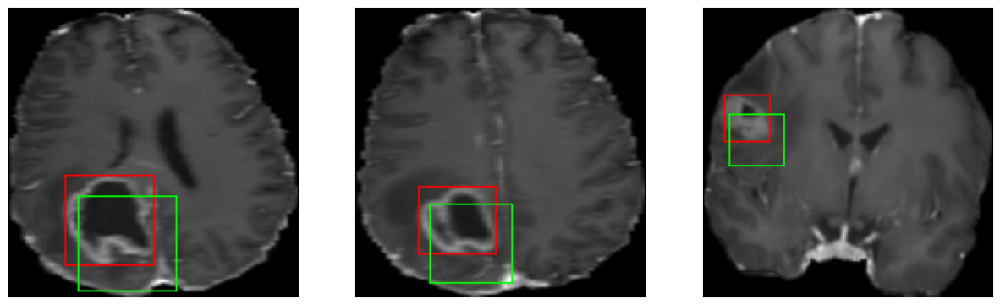

50/50 [==============================] - 7s 133ms/step - loss: 6.7847 - IoU: 0.4848 - val_loss: 11.1540 - val_IoU: 0.3340
Epoch 13/100
7/7 [==============================] - 0s 38ms/step


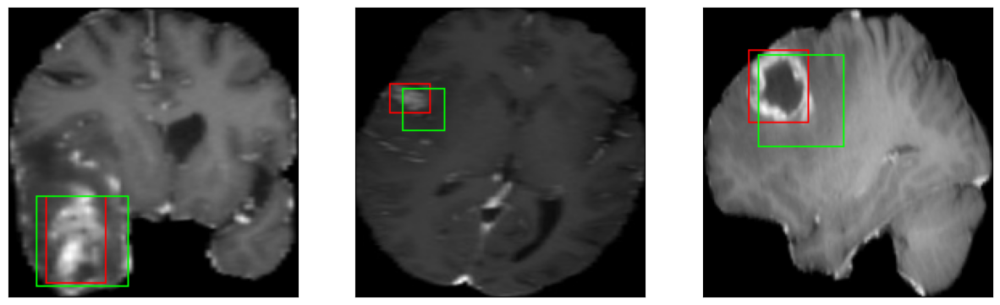

50/50 [==============================] - 7s 147ms/step - loss: 7.1851 - IoU: 0.4543 - val_loss: 11.3645 - val_IoU: 0.3709
Epoch 14/100
7/7 [==============================] - 0s 38ms/step


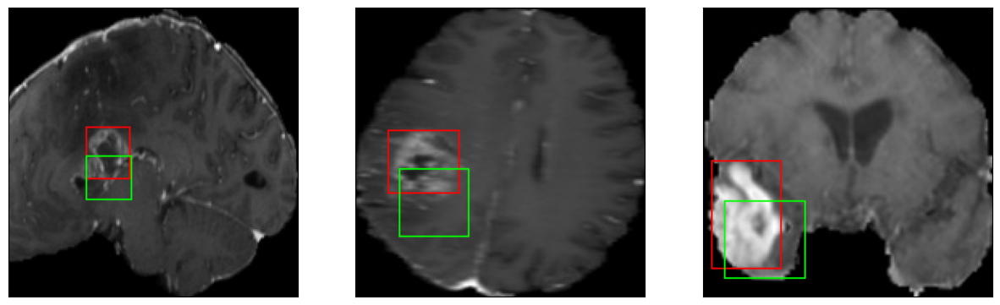

50/50 [==============================] - 7s 135ms/step - loss: 6.9208 - IoU: 0.4709 - val_loss: 10.7844 - val_IoU: 0.2424
Epoch 15/100
7/7 [==============================] - 0s 38ms/step


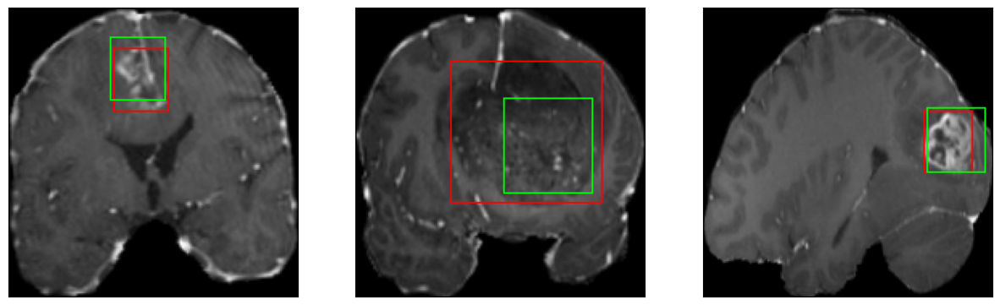

50/50 [==============================] - 7s 145ms/step - loss: 6.5132 - IoU: 0.4945 - val_loss: 6.4232 - val_IoU: 0.5813
Epoch 16/100
7/7 [==============================] - 0s 38ms/step


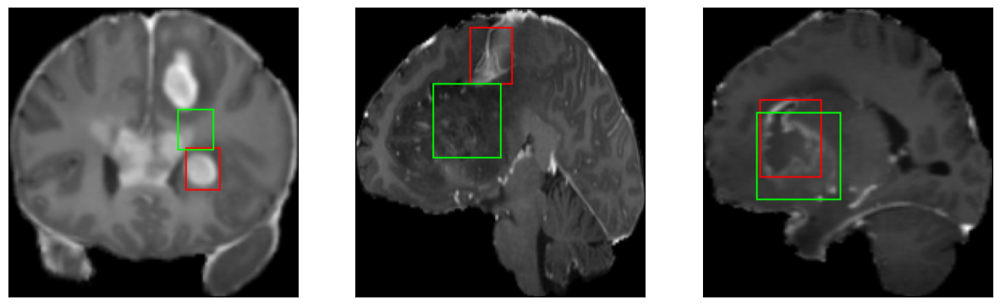

50/50 [==============================] - 7s 135ms/step - loss: 6.2646 - IoU: 0.5055 - val_loss: 7.0813 - val_IoU: 0.5277
Epoch 17/100
7/7 [==============================] - 0s 38ms/step


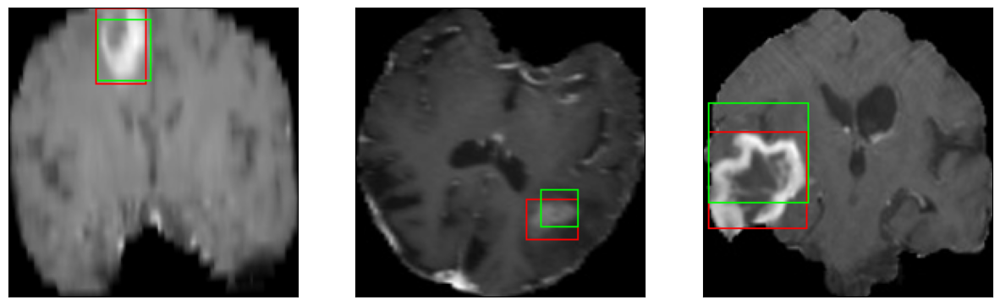

50/50 [==============================] - 7s 146ms/step - loss: 6.4086 - IoU: 0.4953 - val_loss: 7.5209 - val_IoU: 0.4633
Epoch 18/100
7/7 [==============================] - 0s 39ms/step


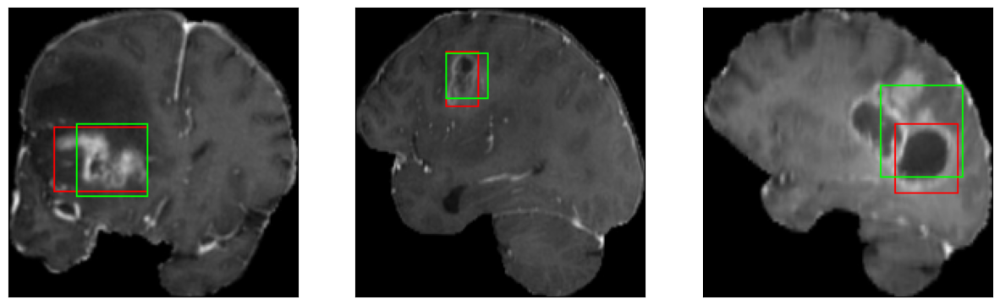

50/50 [==============================] - 7s 140ms/step - loss: 6.8650 - IoU: 0.4666 - val_loss: 7.3993 - val_IoU: 0.4977
Epoch 19/100
7/7 [==============================] - 0s 37ms/step


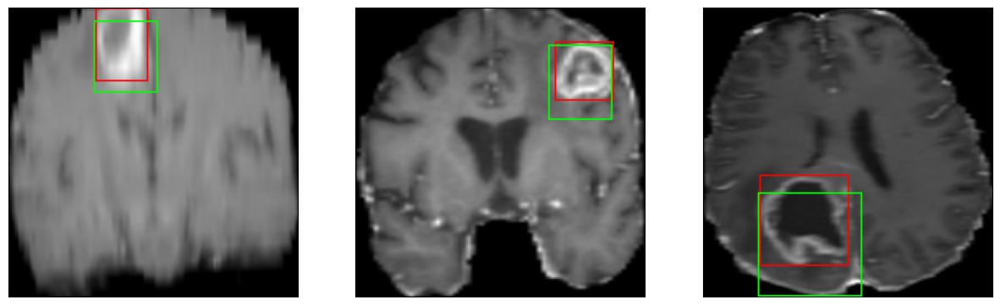

50/50 [==============================] - 7s 137ms/step - loss: 6.4202 - IoU: 0.5007 - val_loss: 9.7469 - val_IoU: 0.4554
Epoch 20/100
7/7 [==============================] - 0s 38ms/step


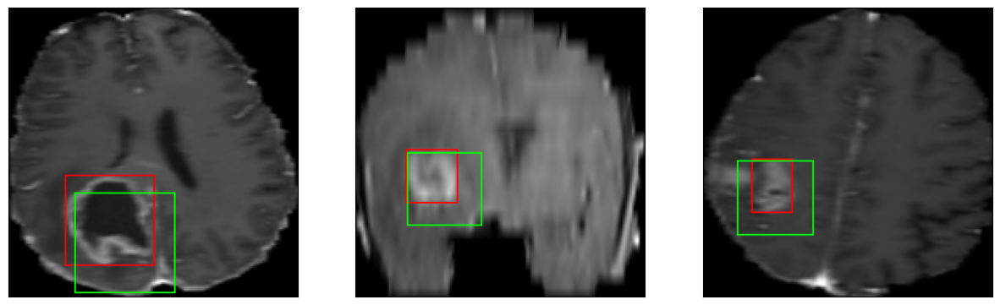

50/50 [==============================] - 7s 137ms/step - loss: 6.0866 - IoU: 0.5160 - val_loss: 10.1372 - val_IoU: 0.4016
Epoch 21/100
7/7 [==============================] - 0s 38ms/step


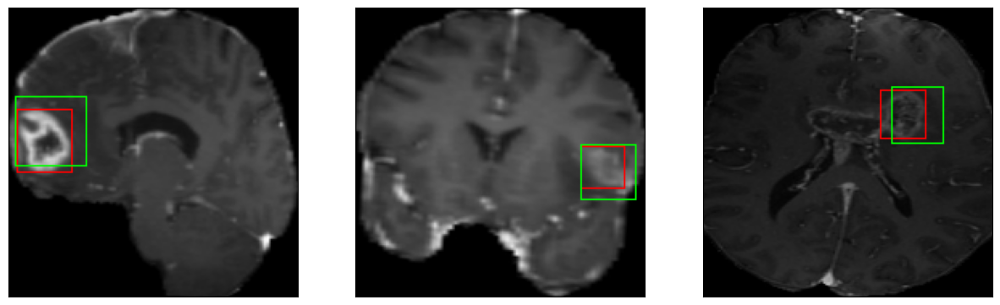

50/50 [==============================] - 7s 150ms/step - loss: 5.9807 - IoU: 0.5316 - val_loss: 7.6239 - val_IoU: 0.4930
Epoch 22/100
7/7 [==============================] - 0s 38ms/step


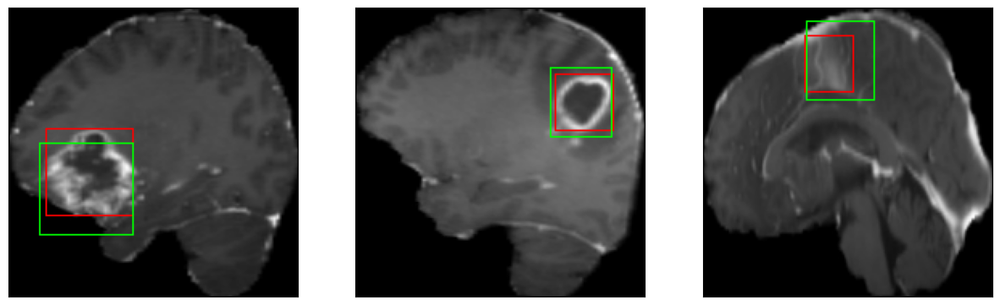

50/50 [==============================] - 7s 139ms/step - loss: 6.0847 - IoU: 0.5273 - val_loss: 6.2932 - val_IoU: 0.5719
Epoch 23/100
7/7 [==============================] - 0s 38ms/step


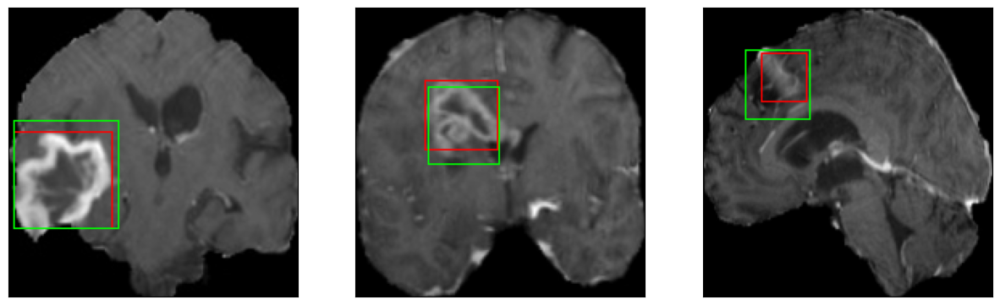

50/50 [==============================] - 8s 153ms/step - loss: 5.6778 - IoU: 0.5599 - val_loss: 8.0766 - val_IoU: 0.5183
Epoch 24/100
7/7 [==============================] - 0s 41ms/step


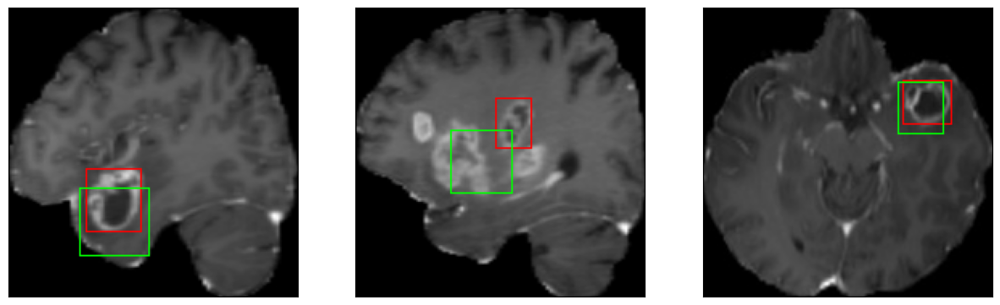

50/50 [==============================] - 7s 140ms/step - loss: 5.7631 - IoU: 0.5404 - val_loss: 7.6410 - val_IoU: 0.4549
Epoch 25/100
7/7 [==============================] - 0s 37ms/step


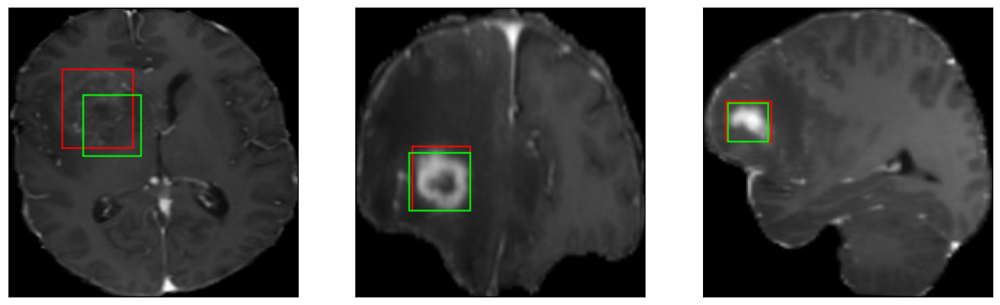

50/50 [==============================] - 7s 137ms/step - loss: 5.4554 - IoU: 0.5716 - val_loss: 6.2896 - val_IoU: 0.5898
Epoch 26/100
7/7 [==============================] - 0s 38ms/step


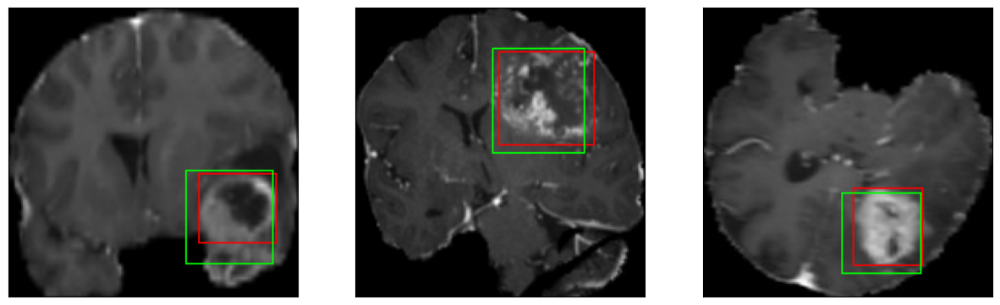

50/50 [==============================] - 8s 157ms/step - loss: 5.5544 - IoU: 0.5527 - val_loss: 6.7880 - val_IoU: 0.5903
Epoch 27/100
7/7 [==============================] - 0s 37ms/step


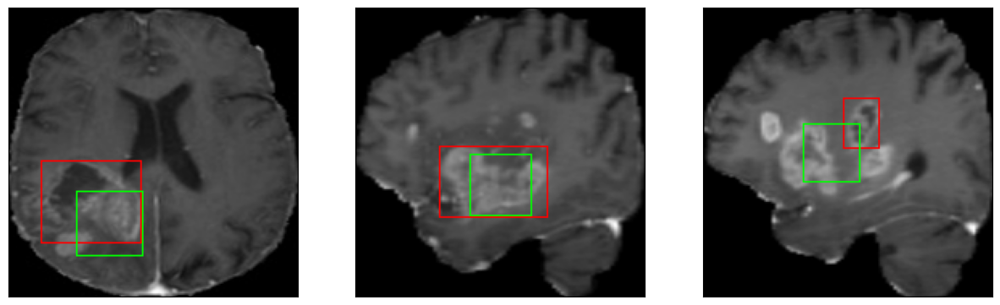

50/50 [==============================] - 7s 140ms/step - loss: 5.4986 - IoU: 0.5649 - val_loss: 6.5607 - val_IoU: 0.5447
Epoch 28/100
7/7 [==============================] - 0s 38ms/step


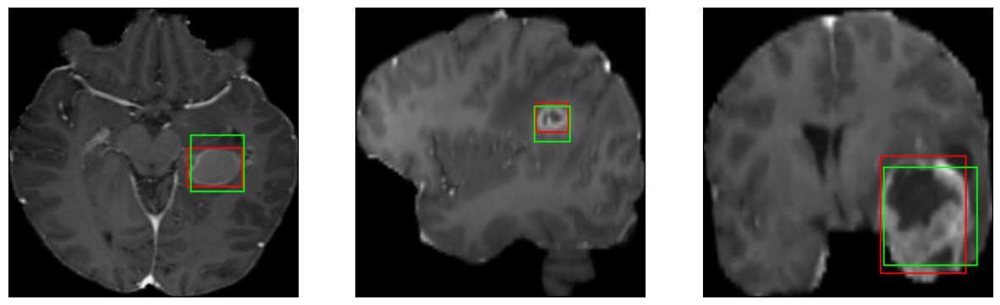

50/50 [==============================] - 7s 138ms/step - loss: 5.3385 - IoU: 0.5736 - val_loss: 5.7993 - val_IoU: 0.6254
Epoch 29/100
7/7 [==============================] - 0s 38ms/step


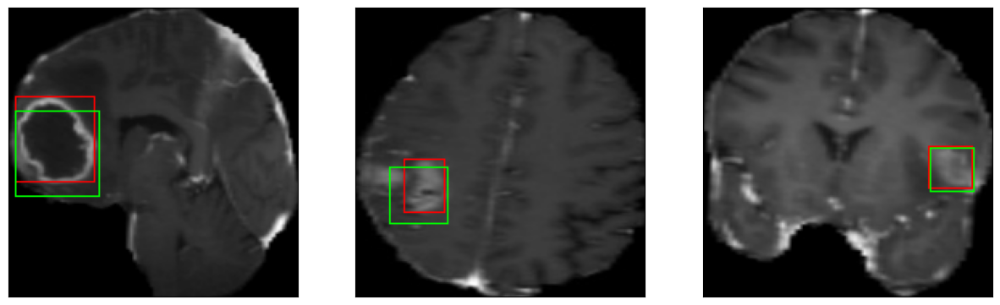

50/50 [==============================] - 7s 141ms/step - loss: 5.6048 - IoU: 0.5565 - val_loss: 6.5299 - val_IoU: 0.5425
Epoch 30/100
7/7 [==============================] - 0s 38ms/step


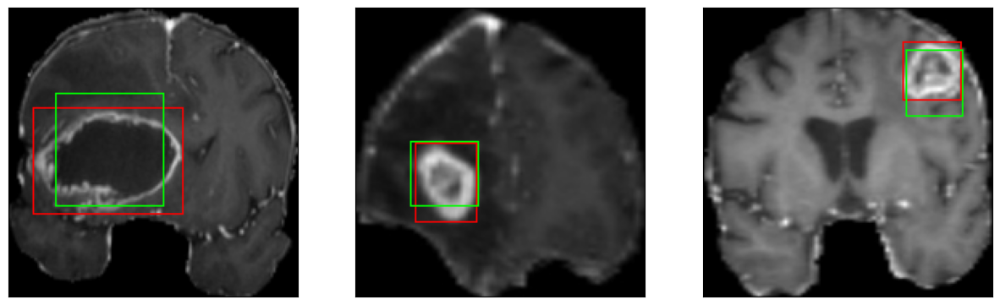

50/50 [==============================] - 8s 154ms/step - loss: 5.2147 - IoU: 0.5907 - val_loss: 5.8899 - val_IoU: 0.6019
Epoch 31/100
7/7 [==============================] - 0s 39ms/step


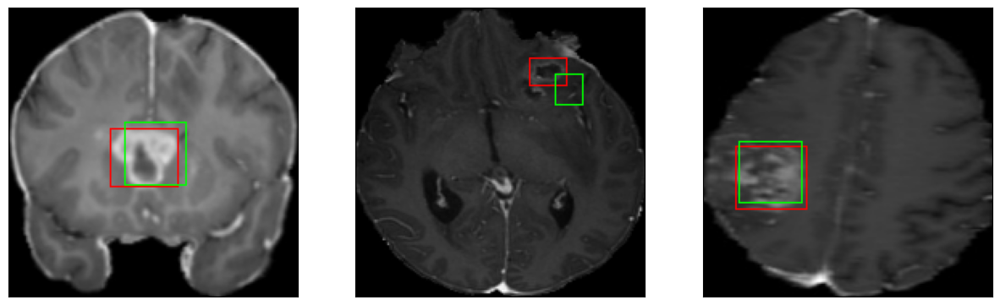

50/50 [==============================] - 7s 141ms/step - loss: 5.3153 - IoU: 0.5817 - val_loss: 6.5520 - val_IoU: 0.5291
Epoch 32/100
7/7 [==============================] - 0s 40ms/step


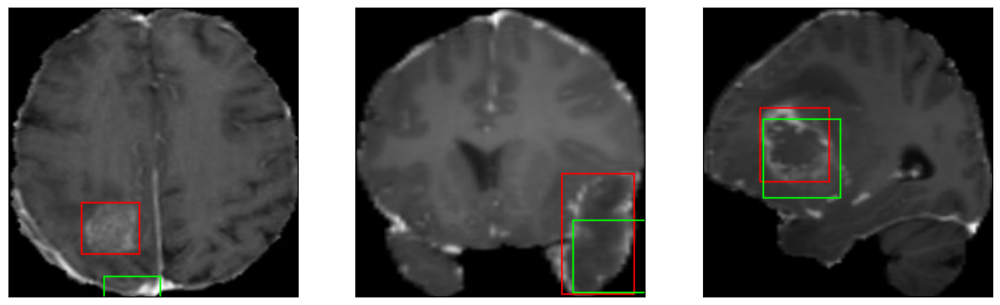

50/50 [==============================] - 8s 156ms/step - loss: 5.2406 - IoU: 0.5870 - val_loss: 9.0785 - val_IoU: 0.3596
Epoch 33/100
7/7 [==============================] - 0s 38ms/step


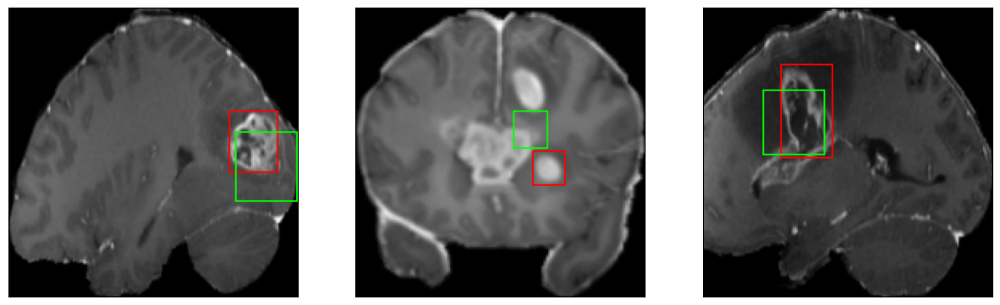

50/50 [==============================] - 7s 139ms/step - loss: 5.1838 - IoU: 0.5851 - val_loss: 8.3821 - val_IoU: 0.3870
Epoch 34/100
7/7 [==============================] - 0s 42ms/step


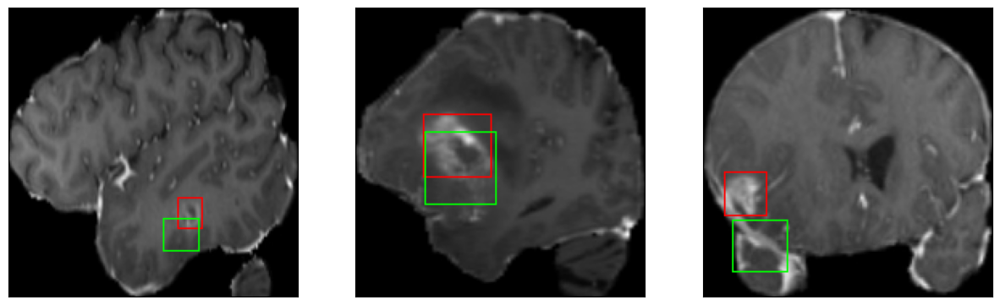

50/50 [==============================] - 9s 179ms/step - loss: 5.0875 - IoU: 0.5964 - val_loss: 8.1888 - val_IoU: 0.4166
Epoch 35/100
7/7 [==============================] - 0s 38ms/step


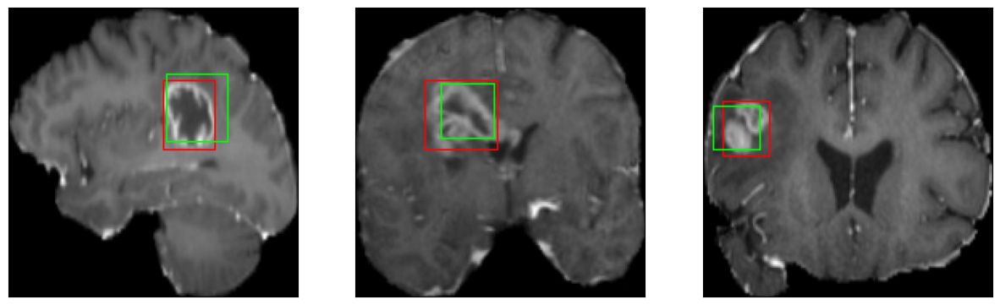

50/50 [==============================] - 7s 140ms/step - loss: 5.2448 - IoU: 0.5848 - val_loss: 6.1588 - val_IoU: 0.5582
Epoch 36/100
7/7 [==============================] - 0s 38ms/step


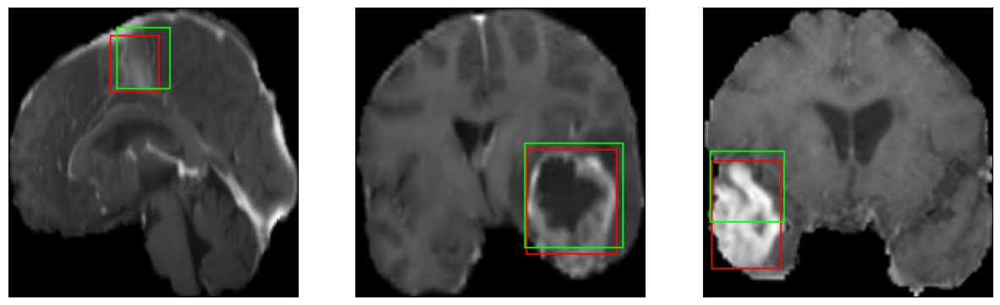

50/50 [==============================] - 7s 138ms/step - loss: 5.2042 - IoU: 0.5871 - val_loss: 7.1242 - val_IoU: 0.5356
Epoch 37/100
7/7 [==============================] - 0s 39ms/step


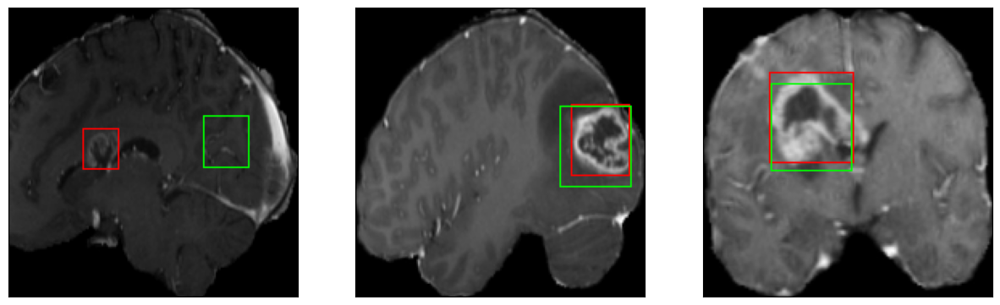

50/50 [==============================] - 8s 153ms/step - loss: 5.1476 - IoU: 0.5923 - val_loss: 6.2016 - val_IoU: 0.5780
Epoch 38/100
7/7 [==============================] - 0s 40ms/step


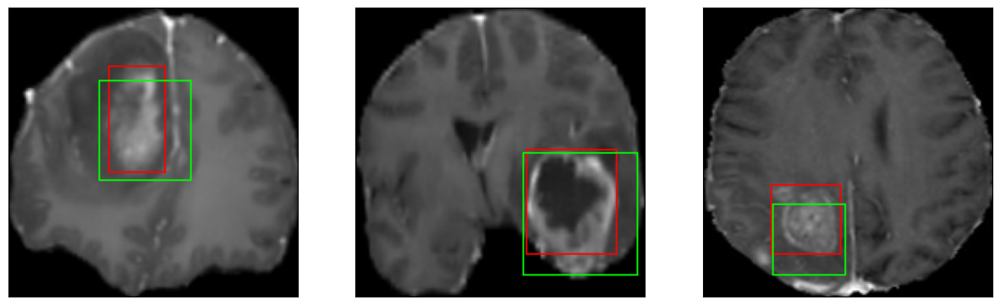

50/50 [==============================] - 8s 154ms/step - loss: 5.0119 - IoU: 0.6004 - val_loss: 9.1209 - val_IoU: 0.5102
Epoch 39/100
7/7 [==============================] - 0s 39ms/step


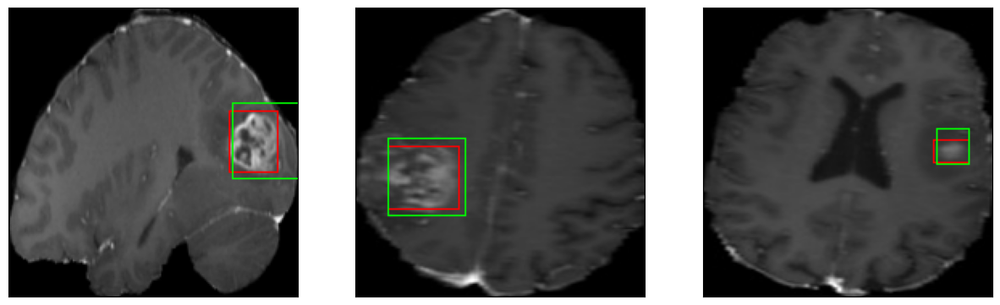

50/50 [==============================] - 7s 140ms/step - loss: 4.9445 - IoU: 0.6084 - val_loss: 7.0877 - val_IoU: 0.5230
Epoch 40/100
7/7 [==============================] - 0s 38ms/step


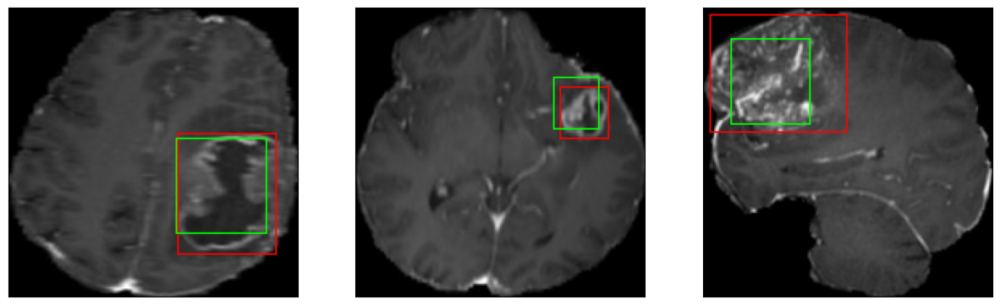

50/50 [==============================] - 7s 143ms/step - loss: 4.7016 - IoU: 0.6228 - val_loss: 6.4481 - val_IoU: 0.5432
Epoch 41/100
7/7 [==============================] - 0s 40ms/step


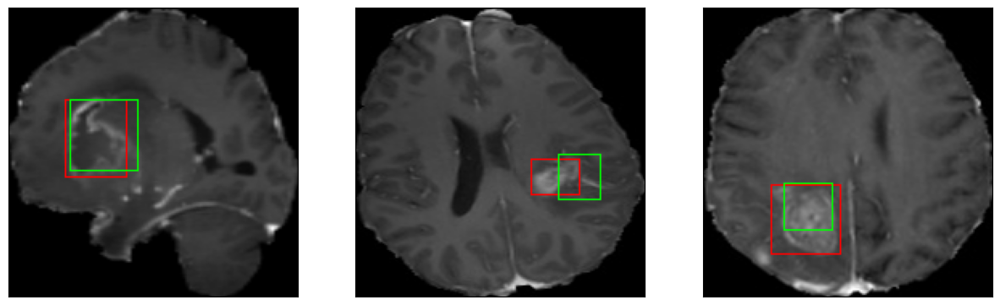

50/50 [==============================] - 8s 158ms/step - loss: 5.0586 - IoU: 0.5939 - val_loss: 7.4399 - val_IoU: 0.4112
Epoch 42/100
7/7 [==============================] - 0s 39ms/step


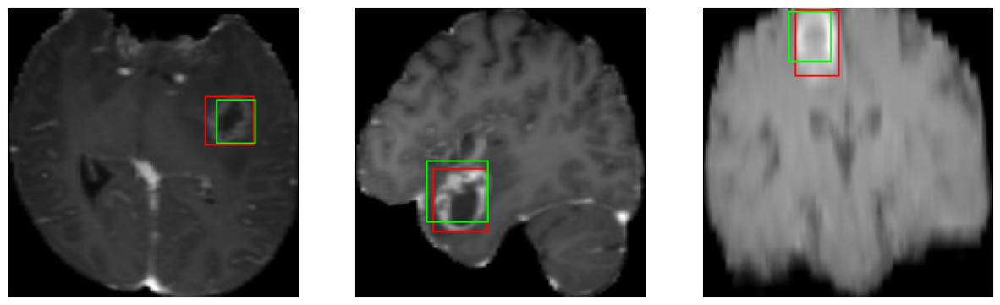

50/50 [==============================] - 7s 142ms/step - loss: 4.7904 - IoU: 0.6234 - val_loss: 6.4704 - val_IoU: 0.5743
Epoch 43/100
7/7 [==============================] - 0s 38ms/step


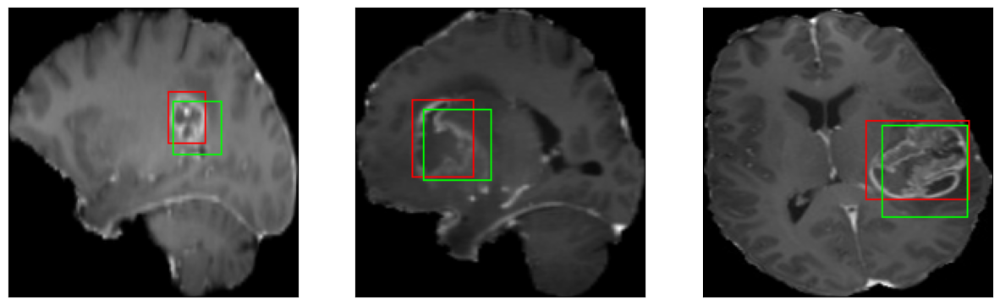

50/50 [==============================] - 7s 143ms/step - loss: 4.7920 - IoU: 0.6219 - val_loss: 6.5507 - val_IoU: 0.5558
Epoch 44/100
7/7 [==============================] - 0s 38ms/step


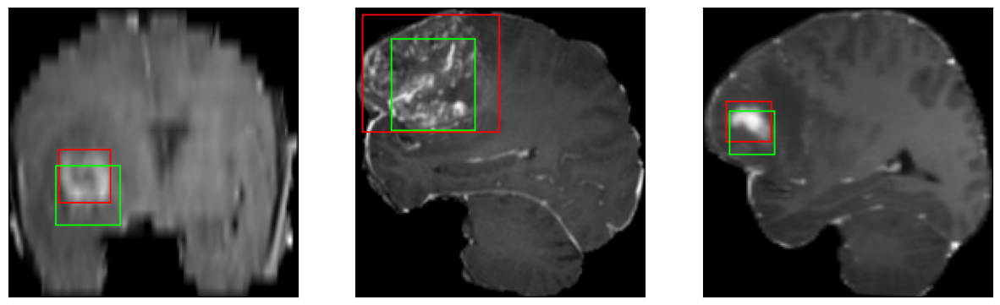

50/50 [==============================] - 8s 156ms/step - loss: 4.8740 - IoU: 0.6115 - val_loss: 9.1679 - val_IoU: 0.4260
Epoch 45/100
7/7 [==============================] - 0s 38ms/step


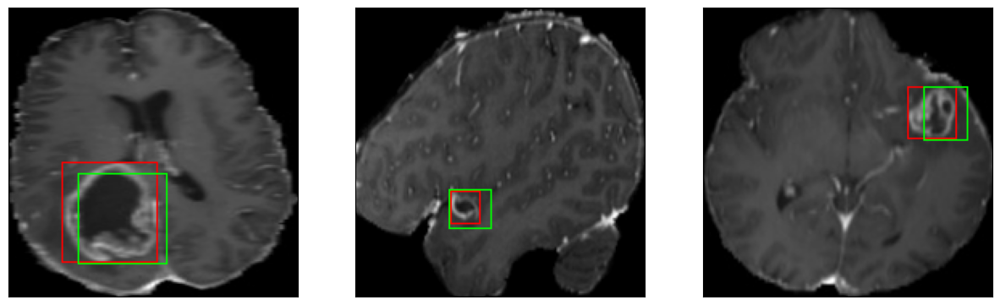

50/50 [==============================] - 7s 147ms/step - loss: 5.0110 - IoU: 0.6103 - val_loss: 6.5717 - val_IoU: 0.5328
Epoch 46/100
7/7 [==============================] - 0s 39ms/step


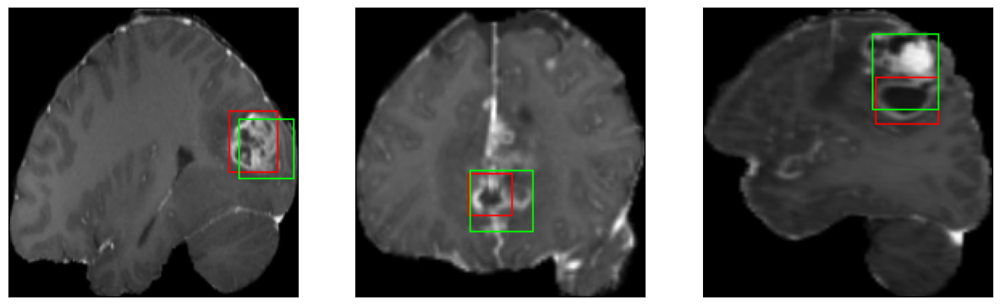

50/50 [==============================] - 8s 151ms/step - loss: 4.7747 - IoU: 0.6230 - val_loss: 5.8491 - val_IoU: 0.6047
Epoch 47/100
7/7 [==============================] - 0s 42ms/step


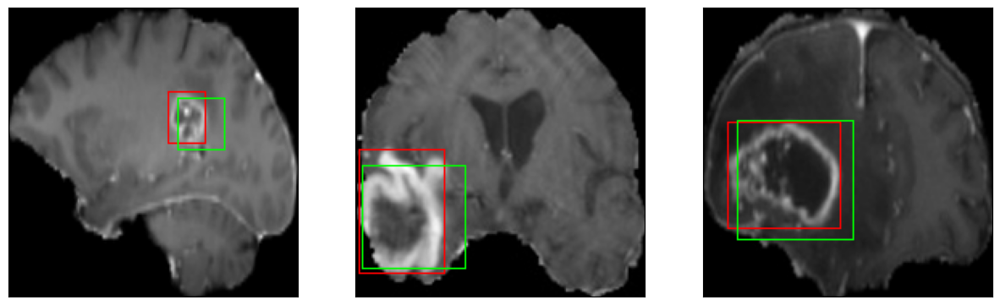

50/50 [==============================] - 8s 157ms/step - loss: 4.8891 - IoU: 0.6140 - val_loss: 6.7655 - val_IoU: 0.5696
Epoch 48/100
7/7 [==============================] - 0s 37ms/step


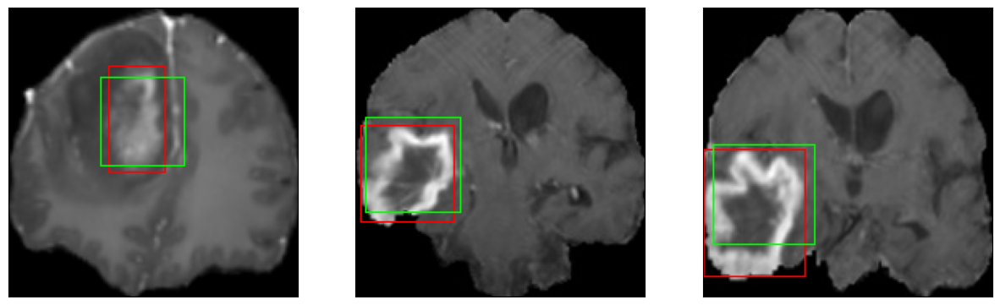

50/50 [==============================] - 7s 148ms/step - loss: 4.7236 - IoU: 0.6204 - val_loss: 7.3349 - val_IoU: 0.5112
Epoch 49/100
7/7 [==============================] - 0s 38ms/step


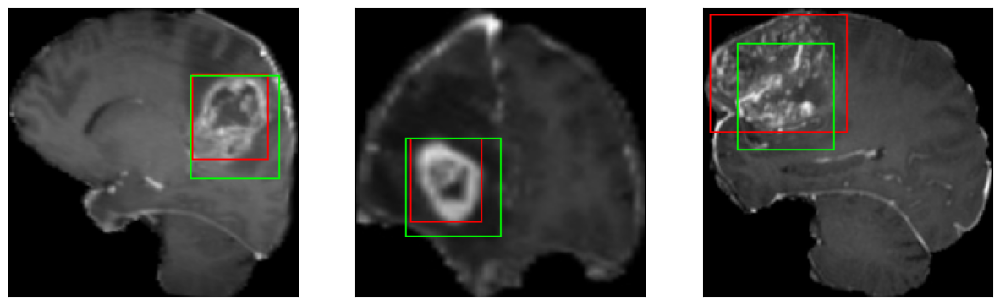

50/50 [==============================] - 8s 157ms/step - loss: 4.6968 - IoU: 0.6236 - val_loss: 8.0170 - val_IoU: 0.5377
Epoch 50/100
7/7 [==============================] - 0s 38ms/step


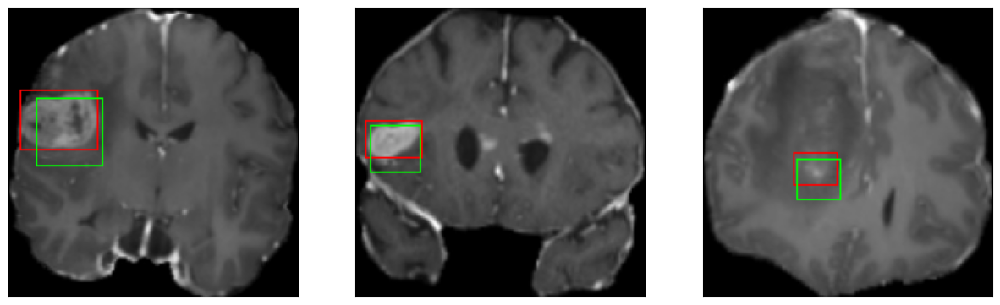

50/50 [==============================] - 7s 146ms/step - loss: 4.7119 - IoU: 0.6281 - val_loss: 5.9307 - val_IoU: 0.6240
Epoch 51/100
7/7 [==============================] - 0s 38ms/step


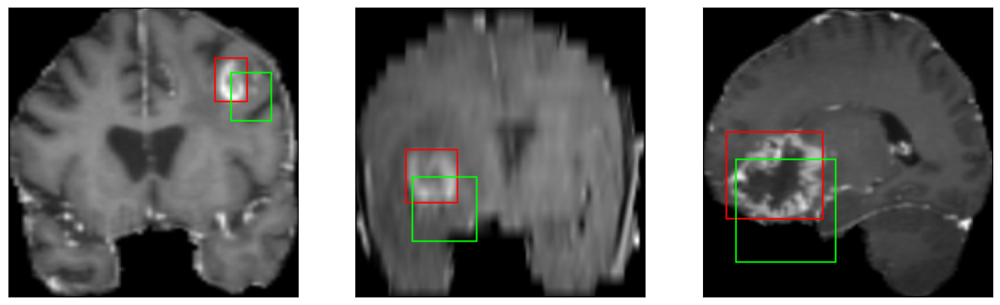

50/50 [==============================] - 8s 153ms/step - loss: 4.8301 - IoU: 0.6185 - val_loss: 10.9245 - val_IoU: 0.2992
Epoch 52/100
7/7 [==============================] - 0s 42ms/step


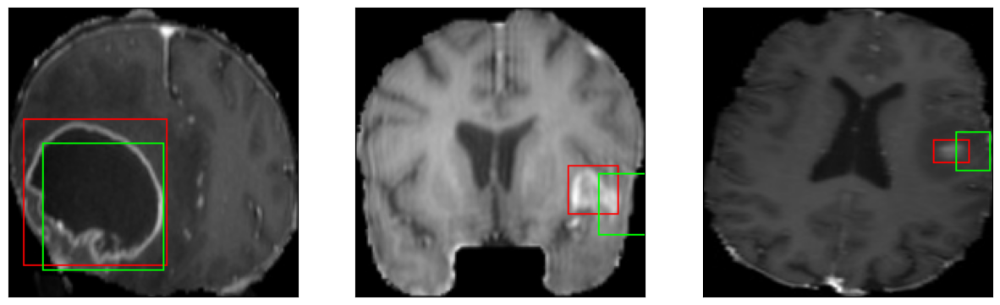

50/50 [==============================] - 7s 146ms/step - loss: 4.7754 - IoU: 0.6153 - val_loss: 8.1517 - val_IoU: 0.4126
Epoch 53/100
7/7 [==============================] - 0s 39ms/step


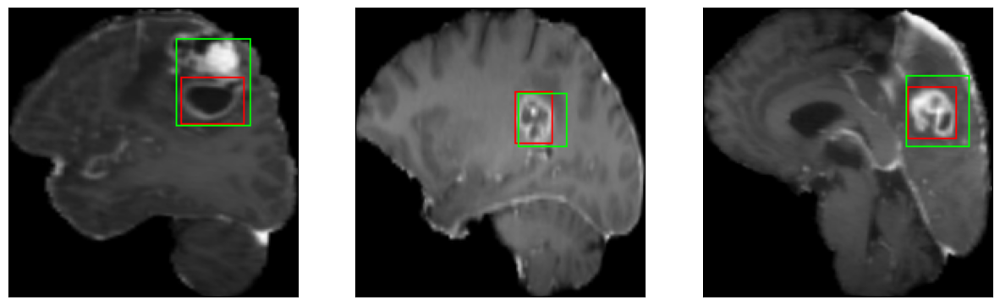

50/50 [==============================] - 7s 145ms/step - loss: 4.4639 - IoU: 0.6378 - val_loss: 6.1145 - val_IoU: 0.6189
Epoch 54/100
7/7 [==============================] - 0s 38ms/step


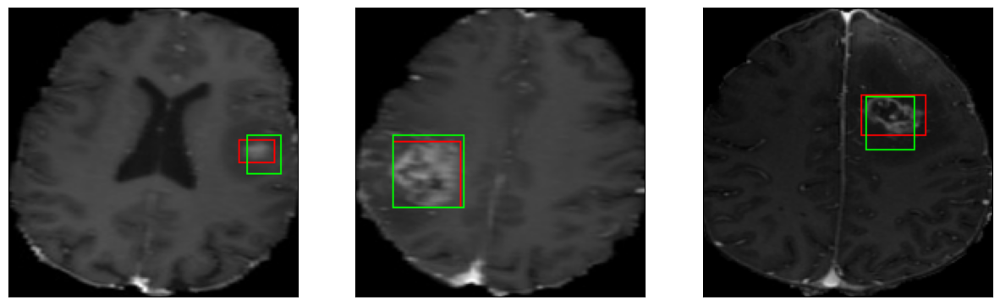

50/50 [==============================] - 7s 149ms/step - loss: 4.4654 - IoU: 0.6428 - val_loss: 6.3477 - val_IoU: 0.5971
Epoch 55/100
7/7 [==============================] - 0s 39ms/step


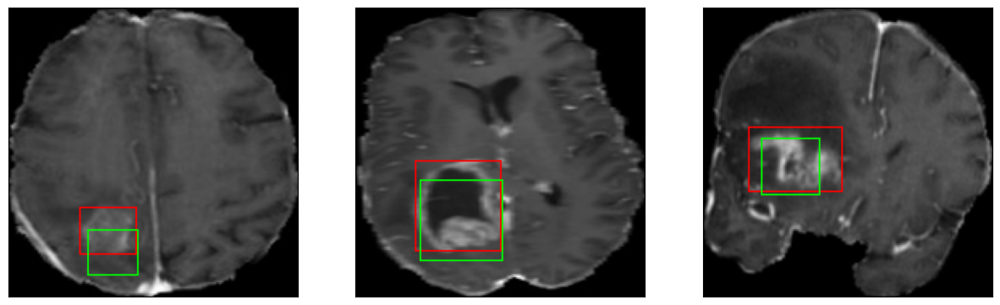

50/50 [==============================] - 8s 157ms/step - loss: 4.6767 - IoU: 0.6292 - val_loss: 6.4360 - val_IoU: 0.5189
Epoch 56/100
7/7 [==============================] - 0s 38ms/step


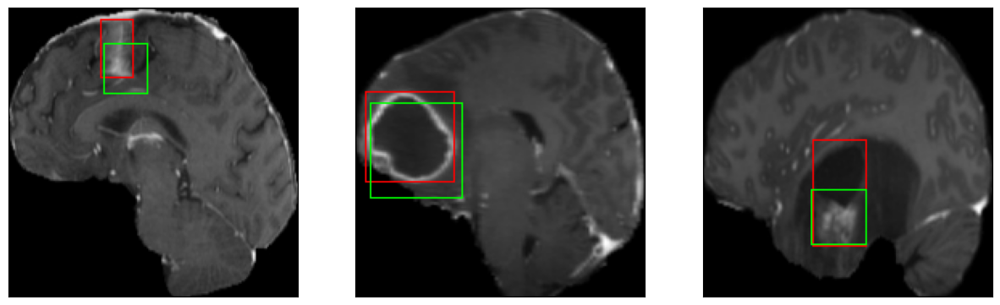

50/50 [==============================] - 7s 145ms/step - loss: 4.4996 - IoU: 0.6411 - val_loss: 6.1872 - val_IoU: 0.5986
Epoch 57/100
7/7 [==============================] - 0s 38ms/step


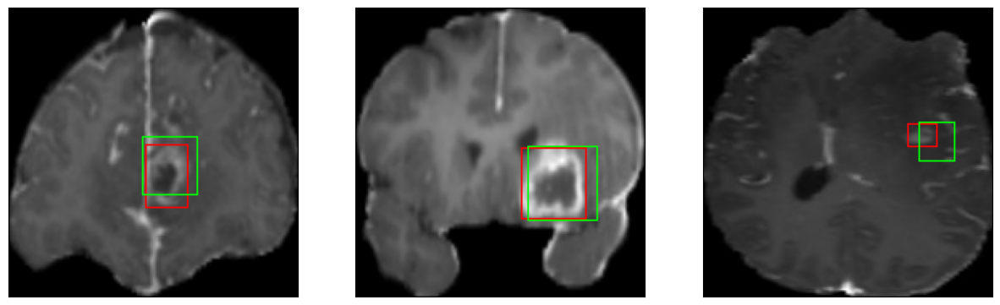

50/50 [==============================] - 7s 149ms/step - loss: 4.6148 - IoU: 0.6381 - val_loss: 6.1840 - val_IoU: 0.5812
Epoch 58/100
7/7 [==============================] - 0s 38ms/step


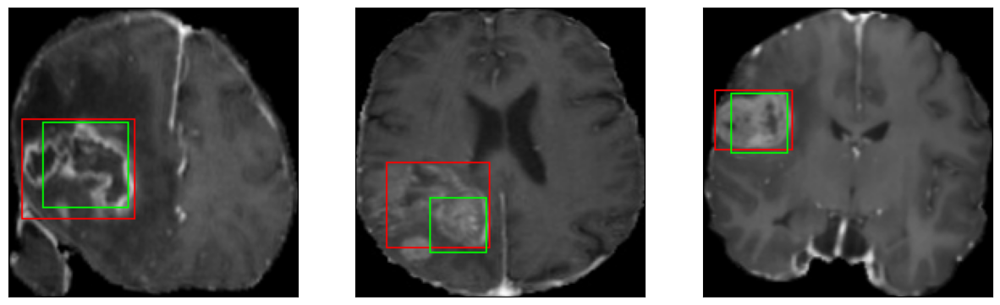

50/50 [==============================] - 8s 157ms/step - loss: 4.5625 - IoU: 0.6287 - val_loss: 6.1175 - val_IoU: 0.6118
Epoch 59/100
7/7 [==============================] - 0s 38ms/step


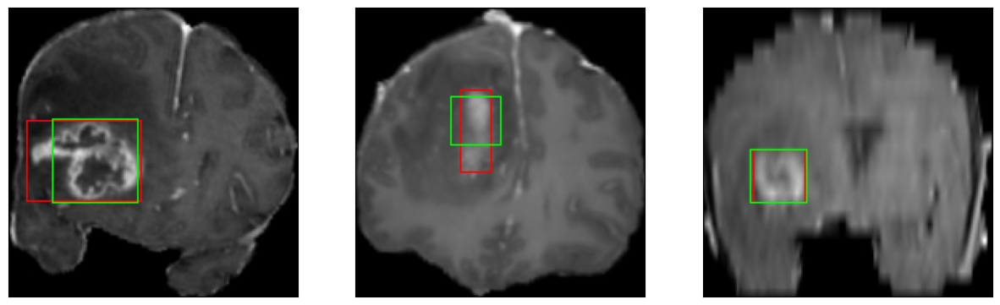

50/50 [==============================] - 7s 145ms/step - loss: 4.4687 - IoU: 0.6458 - val_loss: 5.8251 - val_IoU: 0.6233
Epoch 60/100
7/7 [==============================] - 0s 38ms/step


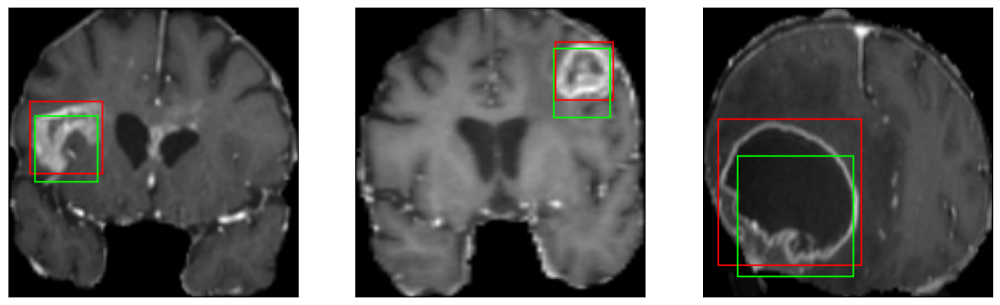

50/50 [==============================] - 8s 151ms/step - loss: 4.3723 - IoU: 0.6484 - val_loss: 6.1338 - val_IoU: 0.5755
Epoch 61/100
7/7 [==============================] - 0s 38ms/step


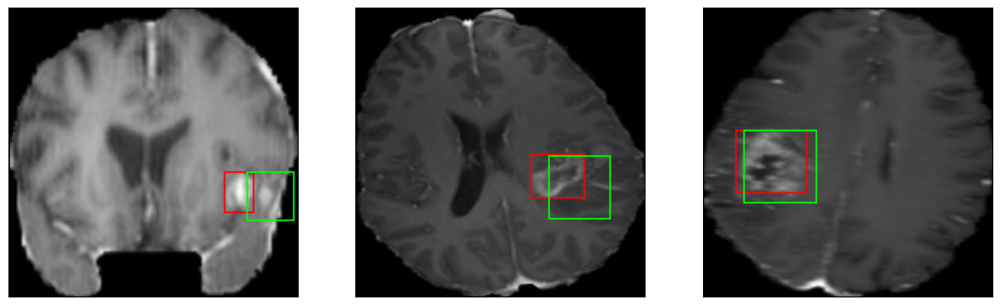

50/50 [==============================] - 8s 154ms/step - loss: 4.4615 - IoU: 0.6375 - val_loss: 7.8046 - val_IoU: 0.4574
Epoch 62/100
7/7 [==============================] - 0s 39ms/step


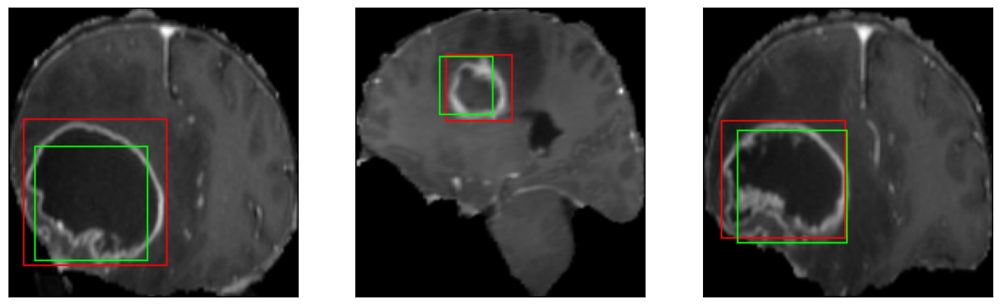

50/50 [==============================] - 7s 142ms/step - loss: 4.6216 - IoU: 0.6287 - val_loss: 6.1462 - val_IoU: 0.6010
Epoch 63/100
7/7 [==============================] - 0s 39ms/step


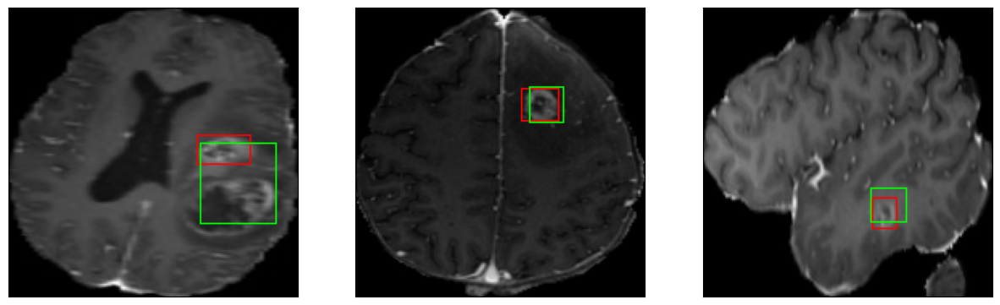

50/50 [==============================] - 8s 158ms/step - loss: 4.3133 - IoU: 0.6491 - val_loss: 5.5343 - val_IoU: 0.6427
Epoch 64/100
7/7 [==============================] - 0s 41ms/step


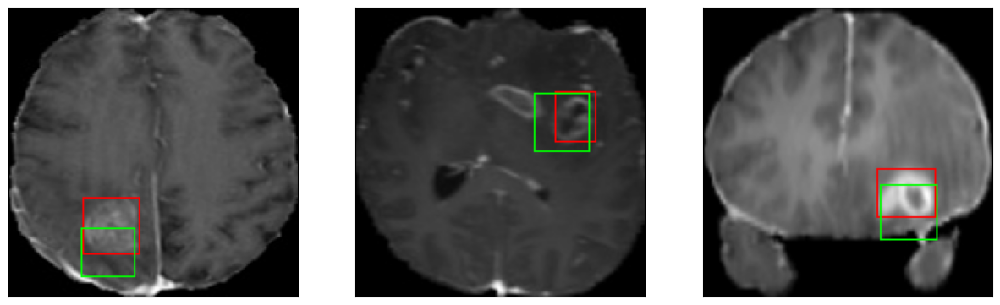

50/50 [==============================] - 7s 150ms/step - loss: 4.4876 - IoU: 0.6410 - val_loss: 6.8215 - val_IoU: 0.5291
Epoch 65/100
7/7 [==============================] - 0s 38ms/step


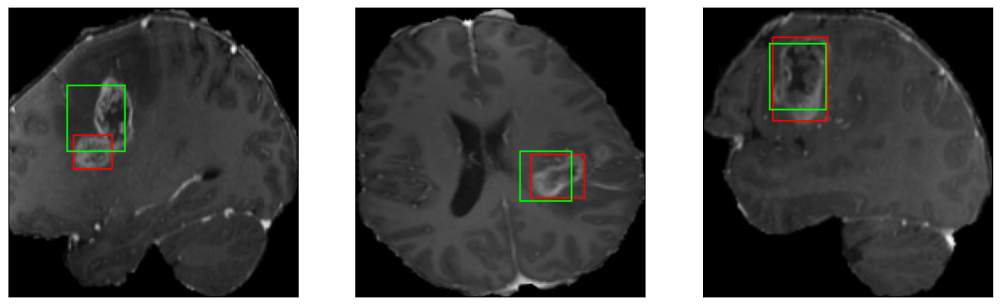

50/50 [==============================] - 8s 159ms/step - loss: 4.5834 - IoU: 0.6354 - val_loss: 6.1716 - val_IoU: 0.5564
Epoch 66/100
7/7 [==============================] - 0s 39ms/step


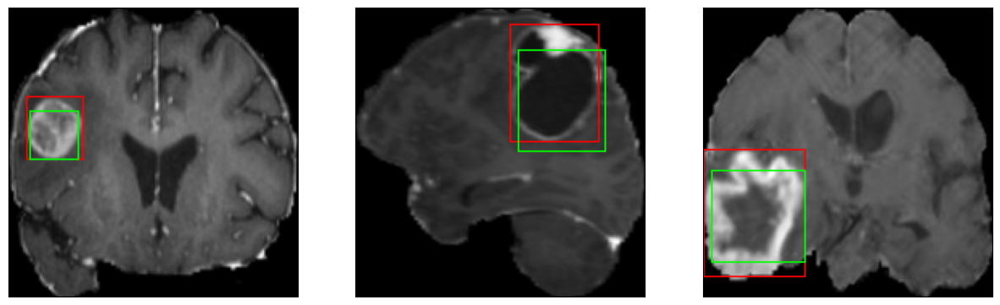

50/50 [==============================] - 8s 156ms/step - loss: 4.3185 - IoU: 0.6377 - val_loss: 6.8426 - val_IoU: 0.5018
Epoch 67/100
7/7 [==============================] - 0s 38ms/step


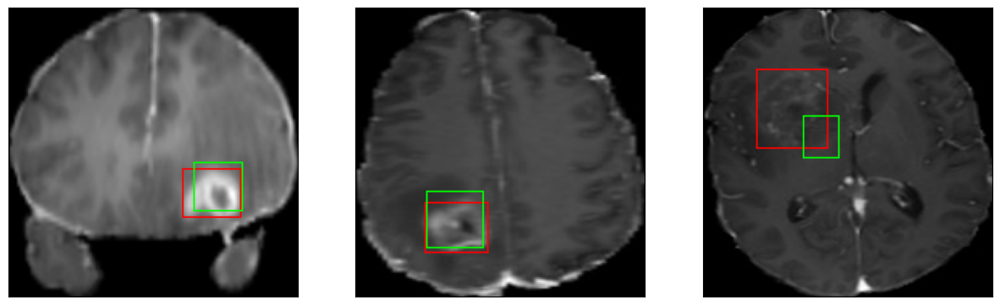

50/50 [==============================] - 7s 146ms/step - loss: 4.4534 - IoU: 0.6311 - val_loss: 5.9774 - val_IoU: 0.6017
Epoch 68/100
7/7 [==============================] - 0s 38ms/step


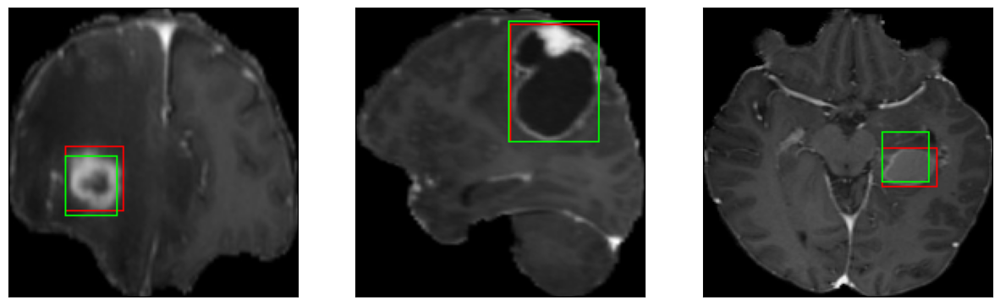

50/50 [==============================] - 8s 156ms/step - loss: 4.1030 - IoU: 0.6484 - val_loss: 5.6517 - val_IoU: 0.6219
Epoch 69/100
7/7 [==============================] - 0s 42ms/step


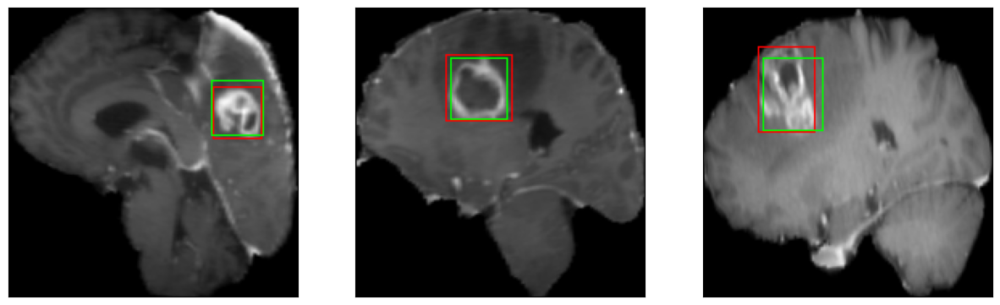

50/50 [==============================] - 7s 146ms/step - loss: 3.8948 - IoU: 0.6590 - val_loss: 5.1986 - val_IoU: 0.6492
Epoch 70/100
7/7 [==============================] - 0s 39ms/step


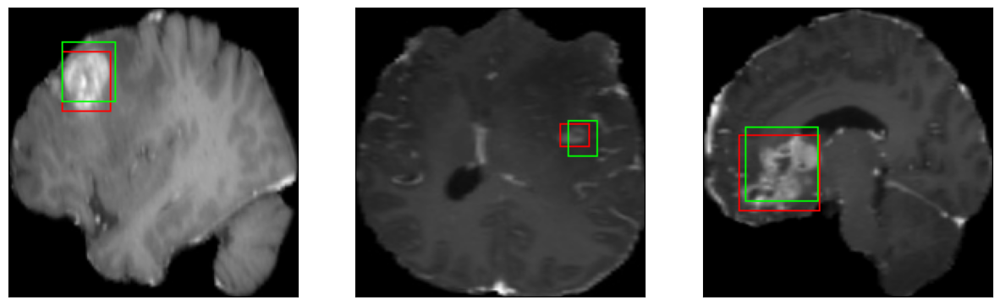

50/50 [==============================] - 8s 155ms/step - loss: 3.9693 - IoU: 0.6537 - val_loss: 5.8639 - val_IoU: 0.5970
Epoch 71/100
7/7 [==============================] - 0s 40ms/step


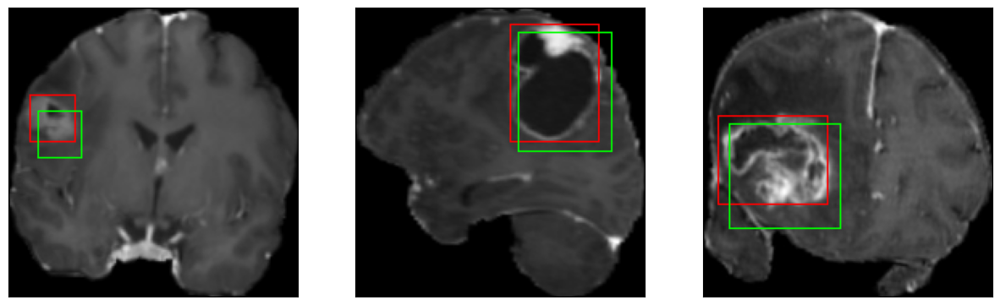

50/50 [==============================] - 7s 149ms/step - loss: 3.7517 - IoU: 0.6651 - val_loss: 6.1942 - val_IoU: 0.5804
Epoch 72/100
7/7 [==============================] - 0s 38ms/step


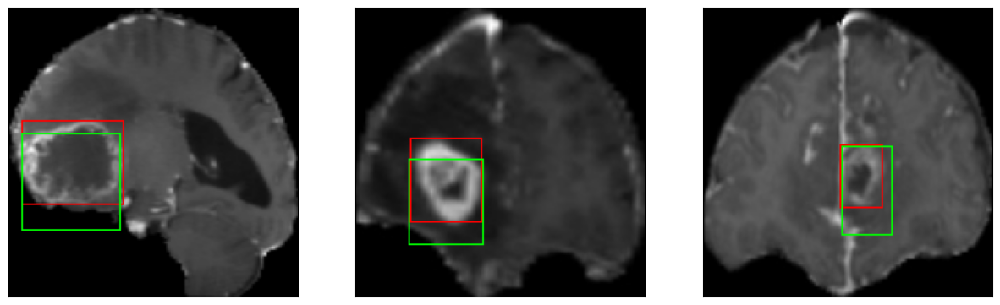

50/50 [==============================] - 7s 146ms/step - loss: 4.1045 - IoU: 0.6375 - val_loss: 7.2248 - val_IoU: 0.4848
Epoch 73/100
7/7 [==============================] - 0s 39ms/step


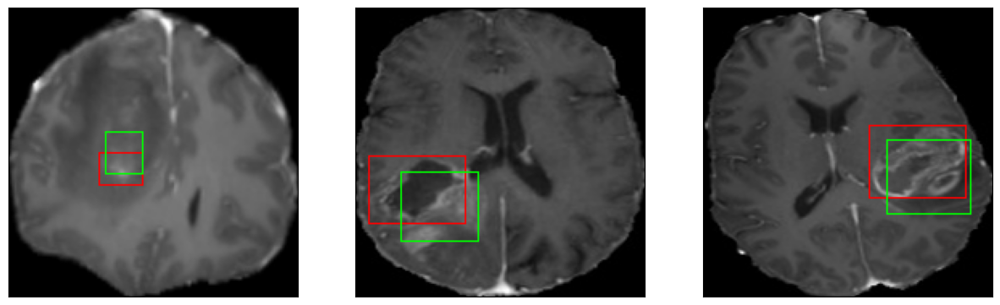

50/50 [==============================] - 8s 156ms/step - loss: 4.1105 - IoU: 0.6432 - val_loss: 5.9239 - val_IoU: 0.5547
Epoch 74/100
7/7 [==============================] - 0s 39ms/step


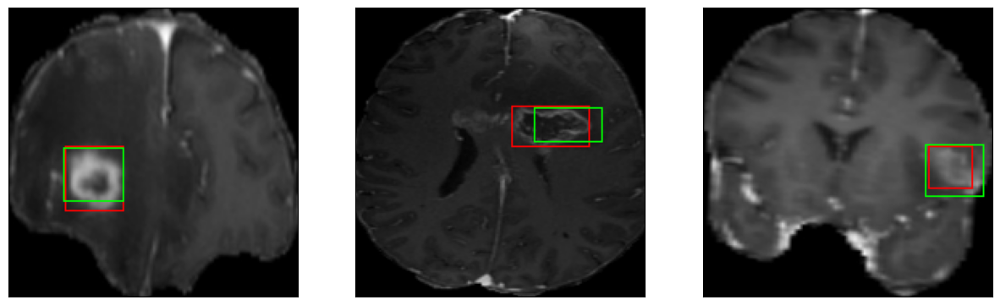

50/50 [==============================] - 7s 147ms/step - loss: 3.9201 - IoU: 0.6530 - val_loss: 5.5203 - val_IoU: 0.6438
Epoch 75/100
7/7 [==============================] - 0s 39ms/step


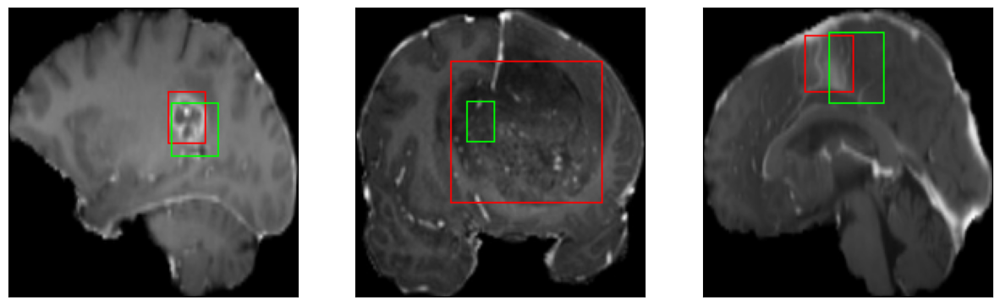

50/50 [==============================] - 8s 155ms/step - loss: 3.6814 - IoU: 0.6698 - val_loss: 6.7263 - val_IoU: 0.5451
Epoch 76/100
7/7 [==============================] - 0s 39ms/step


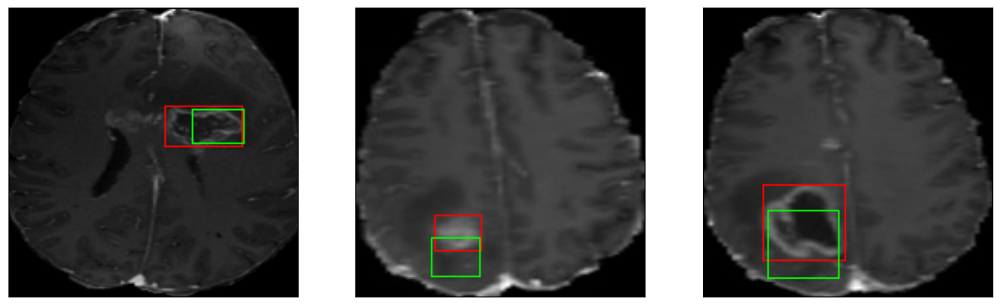

50/50 [==============================] - 7s 150ms/step - loss: 3.5967 - IoU: 0.6728 - val_loss: 5.9806 - val_IoU: 0.5721
Epoch 77/100
7/7 [==============================] - 0s 38ms/step


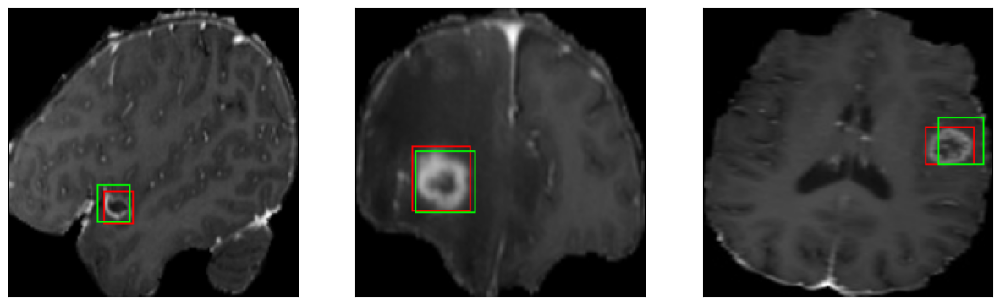

50/50 [==============================] - 7s 141ms/step - loss: 3.8579 - IoU: 0.6538 - val_loss: 6.2839 - val_IoU: 0.5554
Epoch 78/100
7/7 [==============================] - 0s 38ms/step


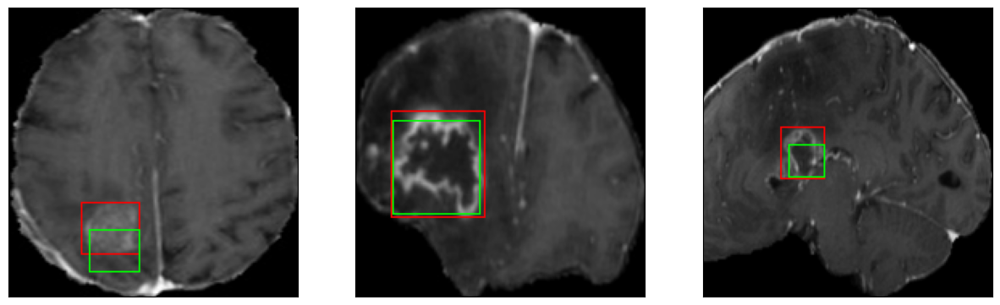

50/50 [==============================] - 8s 156ms/step - loss: 3.8264 - IoU: 0.6640 - val_loss: 5.9688 - val_IoU: 0.5285
Epoch 79/100
7/7 [==============================] - 0s 41ms/step


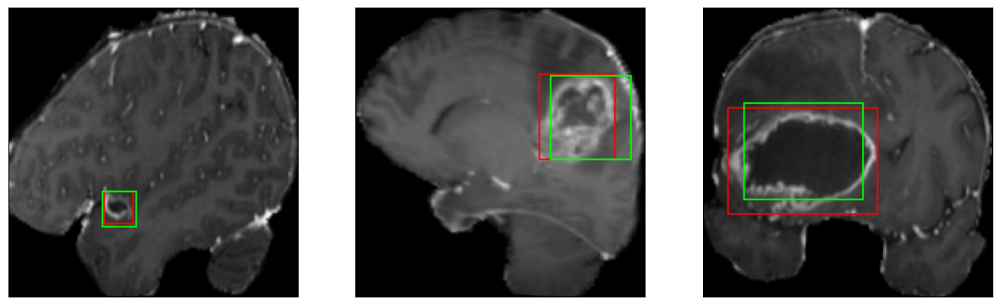

50/50 [==============================] - 8s 153ms/step - loss: 3.6756 - IoU: 0.6735 - val_loss: 5.1697 - val_IoU: 0.6136
Epoch 80/100
7/7 [==============================] - 0s 38ms/step


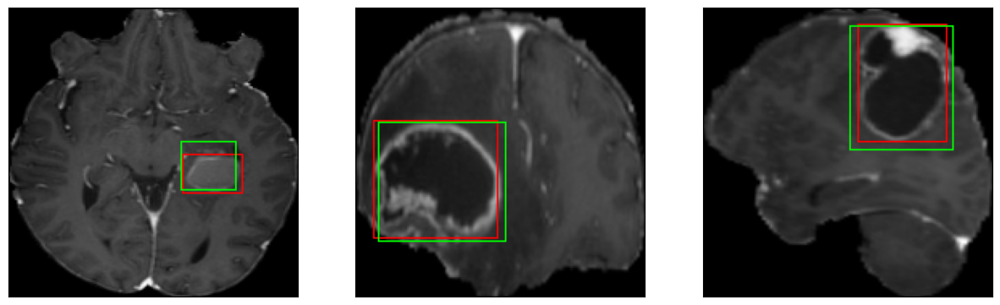

50/50 [==============================] - 8s 151ms/step - loss: 3.8388 - IoU: 0.6553 - val_loss: 4.8737 - val_IoU: 0.6817
Epoch 81/100
7/7 [==============================] - 0s 38ms/step


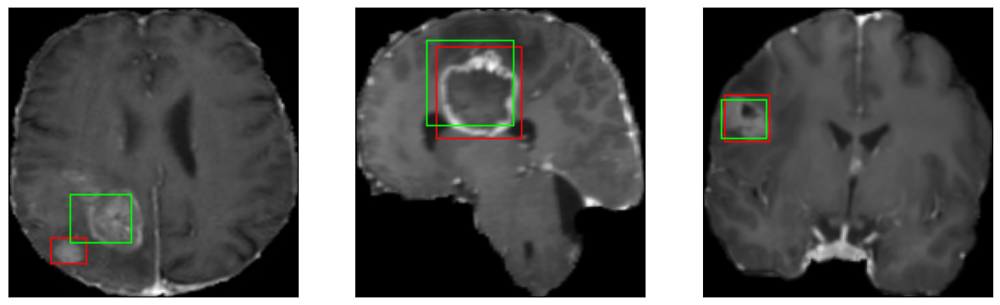

50/50 [==============================] - 7s 145ms/step - loss: 3.4793 - IoU: 0.6794 - val_loss: 5.3271 - val_IoU: 0.6227
Epoch 82/100
7/7 [==============================] - 0s 38ms/step


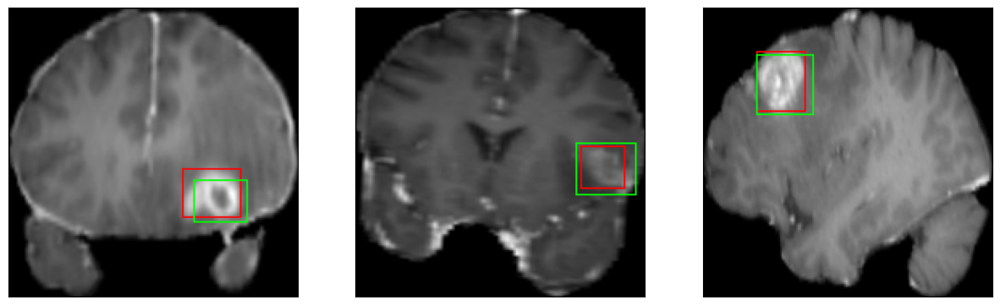

50/50 [==============================] - 7s 144ms/step - loss: 3.8705 - IoU: 0.6495 - val_loss: 5.3827 - val_IoU: 0.5917
Epoch 83/100
7/7 [==============================] - 0s 38ms/step


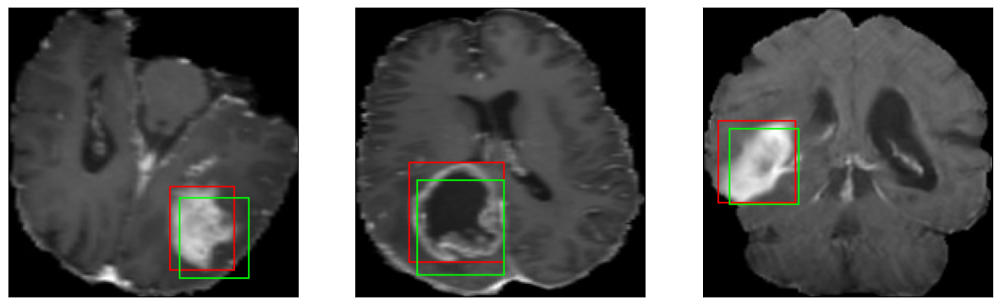

50/50 [==============================] - 8s 156ms/step - loss: 3.5779 - IoU: 0.6741 - val_loss: 5.5649 - val_IoU: 0.5888
Epoch 84/100
7/7 [==============================] - 0s 40ms/step


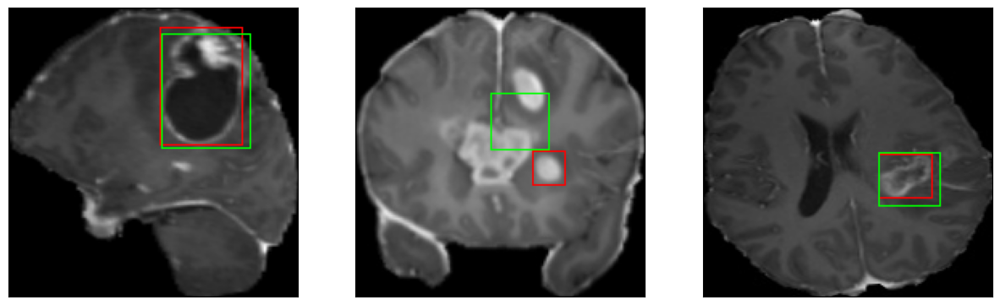

50/50 [==============================] - 8s 155ms/step - loss: 3.5664 - IoU: 0.6640 - val_loss: 5.5467 - val_IoU: 0.6163
Epoch 85/100
7/7 [==============================] - 0s 39ms/step


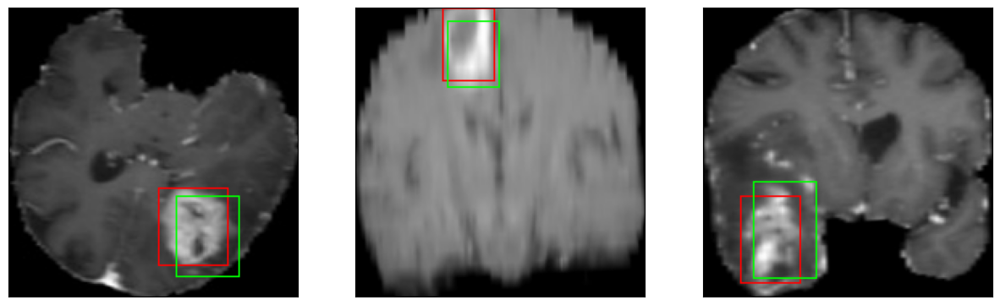

50/50 [==============================] - 7s 144ms/step - loss: 3.5803 - IoU: 0.6700 - val_loss: 6.3793 - val_IoU: 0.5477
Epoch 86/100
7/7 [==============================] - 0s 39ms/step


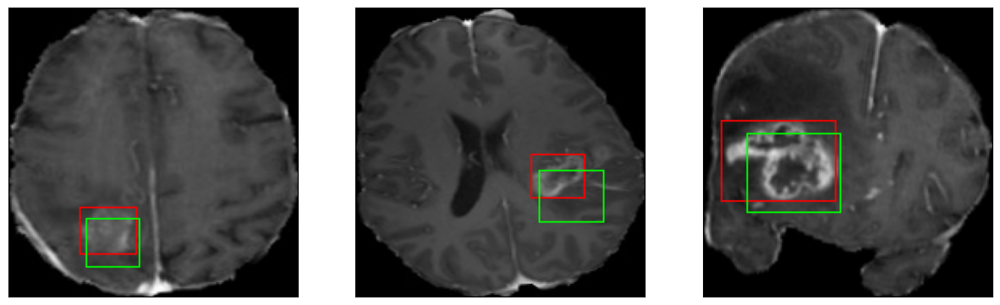

50/50 [==============================] - 8s 158ms/step - loss: 3.4184 - IoU: 0.6797 - val_loss: 6.7512 - val_IoU: 0.4936
Epoch 87/100
7/7 [==============================] - 0s 39ms/step


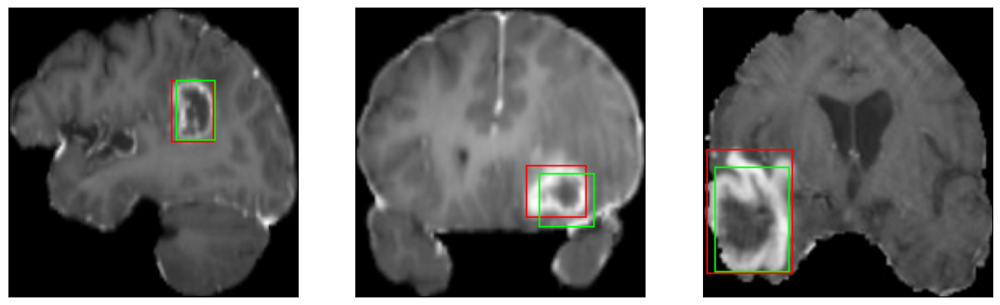

50/50 [==============================] - 7s 147ms/step - loss: 3.5961 - IoU: 0.6665 - val_loss: 5.0308 - val_IoU: 0.6205
Epoch 88/100
7/7 [==============================] - 0s 39ms/step


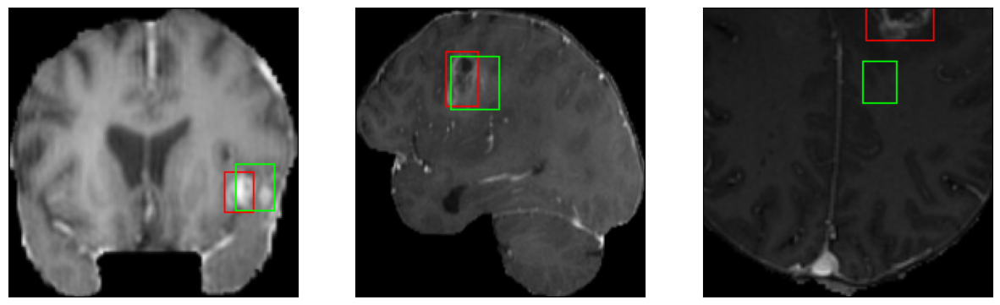

50/50 [==============================] - 7s 148ms/step - loss: 3.5142 - IoU: 0.6698 - val_loss: 5.2893 - val_IoU: 0.6067
Epoch 89/100
7/7 [==============================] - 0s 39ms/step


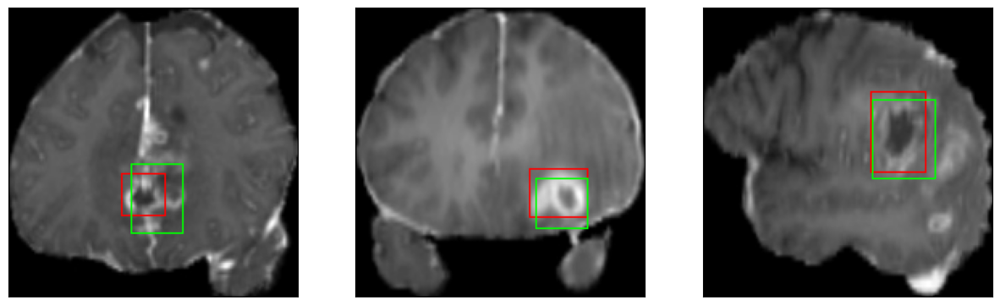

50/50 [==============================] - 8s 160ms/step - loss: 3.2546 - IoU: 0.6963 - val_loss: 4.6112 - val_IoU: 0.6759
Epoch 90/100
7/7 [==============================] - 0s 39ms/step


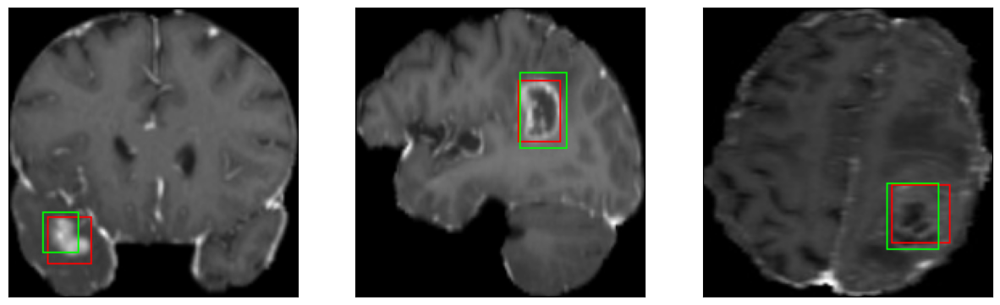

50/50 [==============================] - 7s 146ms/step - loss: 3.3008 - IoU: 0.6867 - val_loss: 4.9556 - val_IoU: 0.6660
Epoch 91/100
7/7 [==============================] - 0s 39ms/step


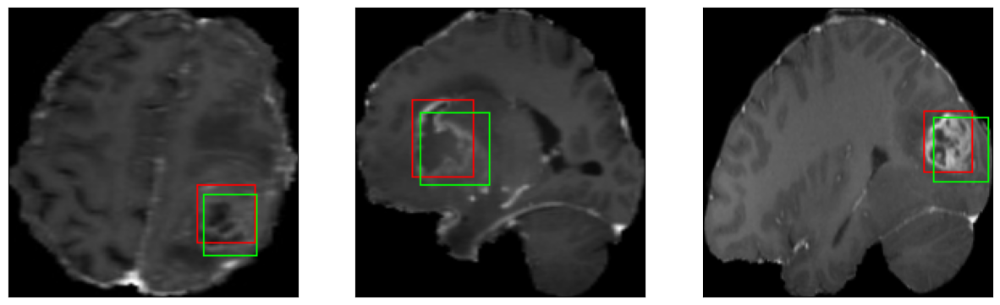

50/50 [==============================] - 8s 158ms/step - loss: 3.5456 - IoU: 0.6672 - val_loss: 6.1800 - val_IoU: 0.5563
Epoch 92/100
7/7 [==============================] - 0s 39ms/step


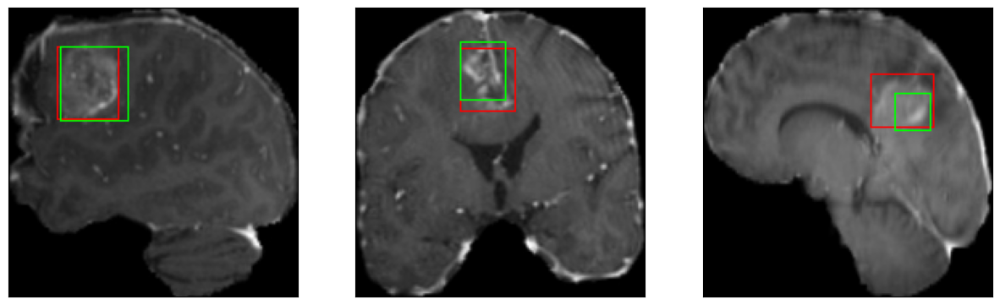

50/50 [==============================] - 7s 142ms/step - loss: 3.4598 - IoU: 0.6759 - val_loss: 5.6132 - val_IoU: 0.5885
Epoch 93/100
7/7 [==============================] - 0s 38ms/step


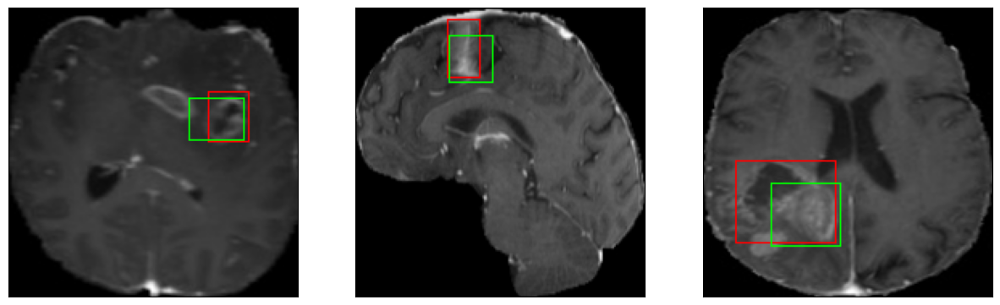

50/50 [==============================] - 8s 168ms/step - loss: 3.4031 - IoU: 0.6828 - val_loss: 5.2466 - val_IoU: 0.6365
Epoch 94/100
7/7 [==============================] - 0s 39ms/step


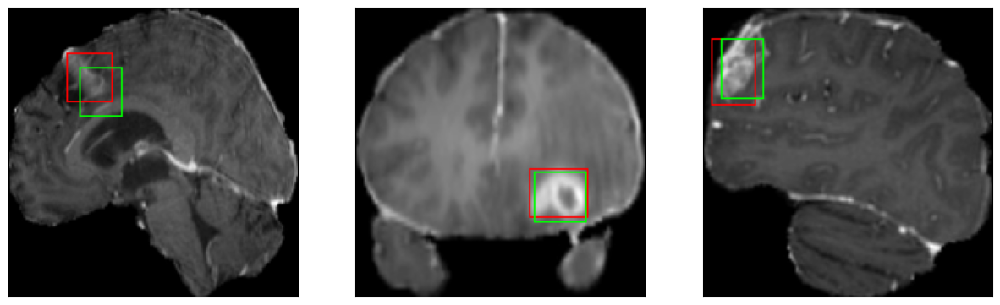

50/50 [==============================] - 7s 148ms/step - loss: 3.3722 - IoU: 0.6878 - val_loss: 4.7568 - val_IoU: 0.6609
Epoch 95/100
7/7 [==============================] - 0s 40ms/step


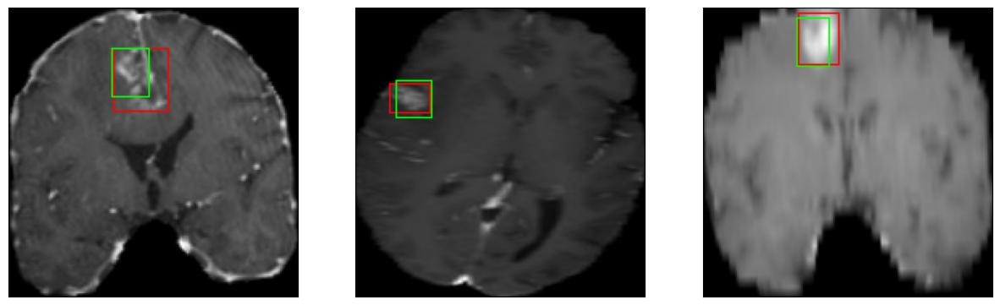

50/50 [==============================] - 7s 147ms/step - loss: 3.4834 - IoU: 0.6795 - val_loss: 4.5161 - val_IoU: 0.6957
Epoch 96/100
7/7 [==============================] - 0s 37ms/step


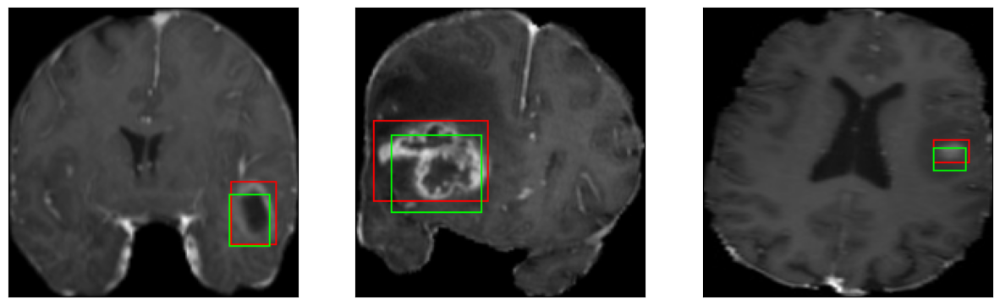

50/50 [==============================] - 7s 148ms/step - loss: 3.1942 - IoU: 0.6935 - val_loss: 6.0155 - val_IoU: 0.5497
Epoch 97/100
7/7 [==============================] - 0s 38ms/step


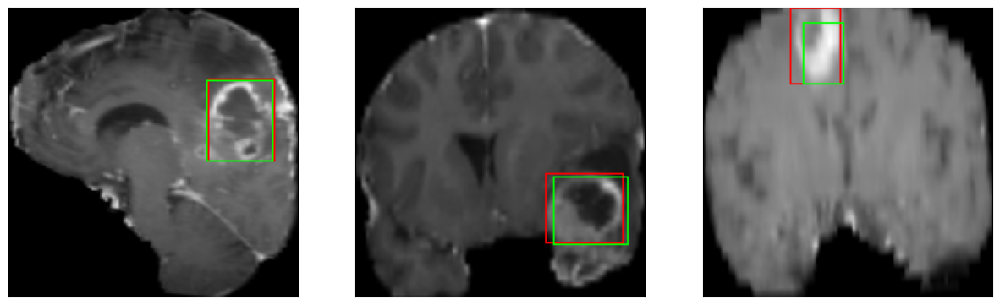

50/50 [==============================] - 7s 145ms/step - loss: 3.4771 - IoU: 0.6703 - val_loss: 5.0806 - val_IoU: 0.6555
Epoch 98/100
7/7 [==============================] - 0s 38ms/step


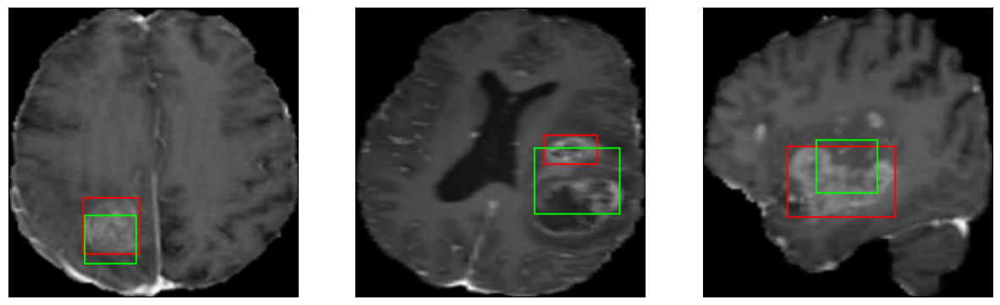

50/50 [==============================] - 8s 154ms/step - loss: 3.2957 - IoU: 0.6829 - val_loss: 4.9275 - val_IoU: 0.6735
Epoch 99/100
7/7 [==============================] - 0s 42ms/step


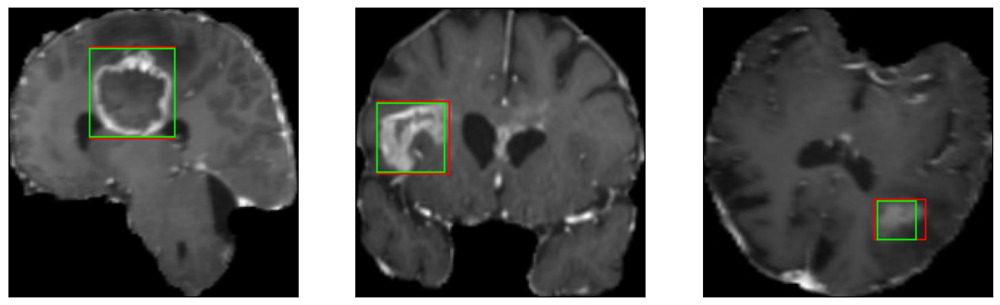

50/50 [==============================] - 7s 150ms/step - loss: 3.4249 - IoU: 0.6732 - val_loss: 4.6348 - val_IoU: 0.6805
Epoch 100/100
7/7 [==============================] - 0s 37ms/step


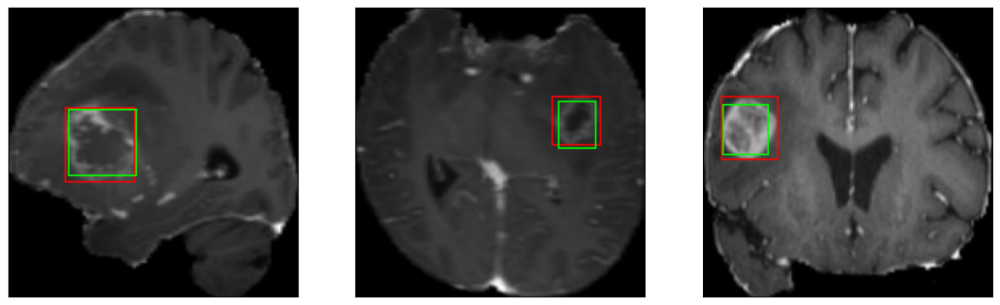

50/50 [==============================] - 7s 142ms/step - loss: 3.2470 - IoU: 0.6850 - val_loss: 5.5604 - val_IoU: 0.6235


In [23]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [24]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
        
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])


In [25]:
model.evaluate(test_dataset)

14/14 [==============================] - 1s 93ms/step - loss: 5.6066 - IoU: 0.6023


[5.606591701507568, 0.6023281216621399]